In [1]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from scipy.misc import face
from scipy.linalg import norm
from skimage import measure
import networkx as nx
from sklearn import cluster
import threading
import Queue
import time
from multiprocessing import cpu_count

In [2]:
#psi
psi=21

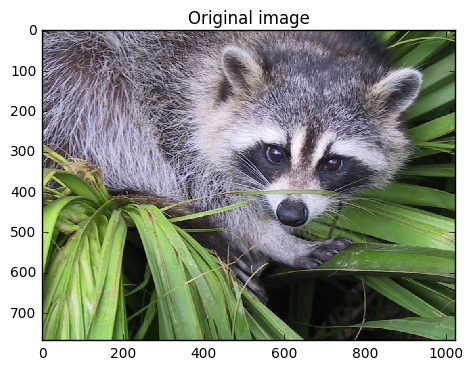

The dim of the image is (768, 1024, 3)


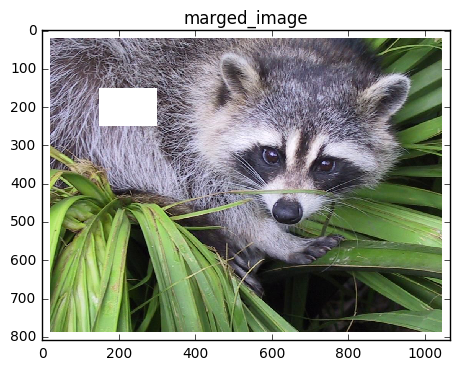

The dim of the image is (810, 1066, 3)


In [3]:
#initialisation of pictures
img = face()
img.reshape((img.shape[0], img.shape[1], -1))
plt.gray()
plt.imshow(img, interpolation='none', norm=Normalize(vmin=0, vmax=255))
plt.title("Original image")
plt.show()
print 'The dim of the image is ' + str(img.shape)

shape = img.shape[2]
#Create a hole
marged_img = (np.zeros((img.shape[0] + 2*psi, img.shape[1] + 2*psi, shape)) - 2).astype(int)
marged_img[psi:-psi, psi:-psi] = img.astype(int).copy()
marged_img[150:250, 150:300] = - np.ones(shape)
plt.imshow(marged_img.astype(np.uint8), interpolation='none', norm=Normalize(vmin=0, vmax=255))
plt.title("marged_image")
plt.show()
print 'The dim of the image is ' + str(marged_img.shape)

In [4]:
#Needed variables
#Create indicator for best match, in order to not reuse applied patch as true patch
indicator = np.ones((marged_img.shape[0], marged_img.shape[1]))
indicator[marged_img[:,:,0]==-1]=-1
indicator[marged_img[:,:,0]==-2]=-1

#Create the confidence matrix
confidence = np.ones((marged_img.shape[0], marged_img.shape[1]))
confidence[marged_img[:,:,0]==-1]=0
confidence[marged_img[:,:,0]==-2]=0

In [5]:
#All needed functions

#find priority term
def confidence_coefficient(confidence, pt, psi=9):
    result = 0
    for i in range(psi):
        for j in range(psi):
            result += confidence[pt[0] + i - (psi-1)/2, pt[1] + j - (psi-1)/2]
    return float(result)/psi**2

#Normal vector to the contour
def gen_normal_vector(omega):
    tangeantes = [(omega[i+1][0] - omega[i-1][0],omega[i+1][1] - omega[i-1][1]) for i in range(1, len(omega)-1)]
    normals = [(-j/np.sqrt(i*i+j*j), i/np.sqrt(i*i+j*j)) for i,j in tangeantes]
    return normals 

#Creation of the data coefficient
def gen_data_vector(normal, isophote, alpha=255.):
    result = [np.abs(normal[i][0] * isophote[i][0] + normal[i][1] * isophote[i][1])/alpha for i in range(len(isophote))]
    return result

#Create a 3d norm
def norm3d(img, param):
    temp = img.reshape((img.shape[0], img.shape[1], -1))
    shape = temp.shape[2]
    result = 0
    for i in range(shape):
        result += norm(img[:, :, i], param)
    return result

#Find the best match
def find_best_match(patch, img, is_compared, patch_x, patch_y, psi=9):
    result = 99999
    result_x = 0
    result_y = 0
    patch_comp = patch * is_compared
    for i in range(psi, img.shape[0]-psi+1):
        for j in range(psi, img.shape[1]-psi+1):
            #print(i, j)
            img_comp = img[i - psi/2: i + psi/2+1, j - psi/2: j + psi/2+1].copy()
            if np.all(img_comp != -1):
                img_comp *= is_compared
                #print(img_comp.shape)
                if norm3d(img_comp - patch_comp, 2) < result:
                    result = norm3d(img_comp - patch_comp, 2)
                    result_x = i
                    result_y = j
    return result_x, result_y

#Find the right contour in the picture
def find_good_contour(contours, img):
    for contour in contours:
        pt = contour[len(contour)/2]
        if np.any(img[pt[0]-1:pt[0]+2, pt[1]-1:pt[1]+2]==-1):
            contour = np.concatenate((np.array([contour[0]]), contour, np.array([contour[-1]])))
            return True, contour
    return False, []

#Find the maximal value in temp
def pooling(temp):
    return np.max(np.abs(temp))

#Compute the gradient of a patch with a hole in it
def get_isophote(pts, img, psi=9):
    isophote = []
    for pt in pts:
        x = pt[0]
        y = pt[1]
        temp = img[x - psi/2: x + psi/2+1, y - psi/2: y + psi/2+1]
        grad = np.gradient(np.ma.masked_where(temp == -1, temp))
        isophote.append((pooling(grad[0]), pooling(grad[1])))
    return isophote

#Small usefull function
def should_be_connected(n1, n2):
    if (len(n1) == 2) & (len(n2) == 2):
        return( ((n1[0]-n2[0])**2 + (n1[1]-n2[1])**2) == 1 )
    else:
        raise NameError("Wrong node")
        
def is_inter(i, pt, psi=9):
    return (i>pt - psi/2-1) & (i<pt + psi/2+1)

def edge_weight(pt1, pt2, old_patch, new_patch):
    return norm3d(old_patch[pt1].reshape((1, 1, -1))-new_patch[pt1].reshape((1, 1, -1)), 2) + \
        norm3d(old_patch[pt2].reshape((1, 1, -1))-new_patch[pt2].reshape((1, 1, -1)), 2)
        
def tuple_in(t, l):
    return (t in l) | ((t[1], t[0]) in l)

#Transform the patch probleme into a graph
def create_graph(img_ini, pt_ini, new_patch, cut_edges, psi=9):
    img = img_ini.reshape((img_ini.shape[0], img_ini.shape[1], -1))
    pt = (int(pt_ini[0] + 0.5), int(pt_ini[1] + 0.5))
    old_patch = img[pt[0] - psi/2 - 1: pt[0] + psi/2 + 2, pt[1] - psi/2 - 1: pt[1] + psi/2 + 2]
    G=nx.Graph()
    G.add_node("old")
    G.add_node("new")
    for i in range(pt[0] - psi/2, pt[0] + psi/2+1):
        firsti = (i == pt[0] - psi/2)
        lasti = (i == pt[0] + psi/2)
        for j in range(pt[1] - psi/2, pt[1] + psi/2+1):
            firstj = (j == pt[1] - psi/2)
            lastj = (j == pt[1] + psi/2)
            if img[i, j, 0] != -1:
                G.add_node((i, j))
                if not firsti:
                    if ((img[i-1, j, 0] == -1) & ((i-1, j) not in G.nodes())):
                        G.add_node((i-1, j))
                        G.add_edge((i-1, j), 'new', weight=np.inf)
                else:
                    G.add_node((i-1, j))
                    G.add_edge((i-1, j), 'old', weight=np.inf)
                if not lasti:
                    if ((img[i+1, j, 0] == -1) & ((i+1, j) not in G.nodes())):
                        G.add_node((i+1, j))
                        G.add_edge((i+1, j), 'new', weight=np.inf)
                else:
                    G.add_node((i+1, j))
                    G.add_edge((i+1, j), 'old', weight=np.inf)
                if not firstj:
                    if ((img[i, j-1, 0] == -1) & ((i, j-1) not in G.nodes())):
                        G.add_node((i, j-1))
                        G.add_edge((i, j-1), 'new', weight=np.inf)
                else:
                    G.add_node((i, j-1))
                    G.add_edge((i, j-1), 'old', weight=np.inf)
                if not lastj:
                    if ((img[i, j+1, 0] == -1) & ((i, j+1) not in G.nodes())):
                        G.add_node((i, j+1))
                        G.add_edge((i, j+1), 'new', weight=np.inf)
                else:
                    G.add_node((i, j+1))
                    G.add_edge((i, j+1), 'old', weight=np.inf)
                for ibis, jbis in [(i-1, j), (i+1,j), (i, j-1), (i, j+1)]:
                    if (not tuple_in(((i,j), (ibis, jbis)), G.edges())) & ((ibis,jbis) in G.nodes()):
                        if ((i,j), (ibis, jbis)) in cut_edges:
                            idemi, jdemi = (float(i+ibis)/2, float(j+jbis)/2)
                            G.add_node((idemi, jdemi))
                            G.add_edge((idemi,jdemi), 'new', cut_edges)
                            G.add_edge((i, j), (idemi, jdemi), weight=edge_weight((i - pt[0] + psi/2 + 1, j - pt[1] + psi/2 + 1), 
                                                                 (idemi - pt[0] + psi/2 + 1, jdemi - pt[1] + psi/2 + 1),
                                                                 old_patch, new_patch))
                            G.add_edge((ibis, jbis), (idemi, jdemi), weight=edge_weight((ibis - pt[0] + psi/2 + 1, jbis - pt[1] + psi/2 + 1), 
                                                                 (idemi - pt[0] + psi/2 + 1, jdemi - pt[1] + psi/2 + 1),
                                                                 old_patch, new_patch))
                        else:
                            G.add_edge((ibis, jbis), (i,j), weight=edge_weight((i - pt[0] + psi/2 + 1, j - pt[1] + psi/2 + 1), 
                                                                     (ibis - pt[0] + psi/2 + 1, jbis - pt[1] + psi/2 + 1),
                                                                     old_patch, new_patch))
    return G

#Find edge which have been cut
def find_cut_edges(G, set_old, dico_cut_edges):
    for edge in G.edges(data=True):
        node1 = edge[0]
        node2 = edge[1]
        if (node1!='old') & (node1!='new') & (node2!='old') & (node2!='new'):
            if ((node1 in set_old) & (node2 not in set_old)) | ((node1 not in set_old) & (node2 in set_old)):
                if np.floor(node1[0]) != node1[0]:
                    node1 = (2 * node1[0] - node2[0], node1[1])
                elif np.floor(node1[1]) != node1[1]:
                    node1 = (node1[0], 2 * node1[1] - node2[1])
                elif np.floor(node2[0]) != node2[0]:
                    node2 = (2 * node2[0] - node1[0], node2[1])
                elif np.floor(node2[1]) != node2[1]:
                    node2 = (node2[0], 2 * node2[1] - node1[1])
                dico_cut_edges[(node1, node2)]= edge[2]["weight"]
                dico_cut_edges[(node2, node1)]= edge[2]["weight"]
    return dico_cut_edges

#Multithreading of findbestmatch
def worker_function(t, queue, img, indicator, is_compared, patch, psi):
    global result, result_x, result_y
    patch_comp = patch * is_compared
    while True:
        i,j = queue.get()
        if (i<psi/2) | (j<psi/2) | (i>img.shape[0]-psi/2-1) | (j>img.shape[1]-psi/2-1):
            queue.task_done()
        else:
            if queue.qsize()%20000 ==0:
                print("The queue size is %s"%queue.qsize())
            img_comp = img[i - psi/2: i + psi/2+1, j - psi/2: j + psi/2+1].copy()
            ind_comp = indicator[i - psi/2: i + psi/2+1, j - psi/2: j + psi/2+1].copy()
            if np.all(ind_comp != -1):
                img_comp *= is_compared
                #print(img_comp.shape)
                if norm3d(img_comp - patch_comp, 2) < result:
                    result = norm3d(img_comp - patch_comp, 2)
                    result_x = i
                    result_y = j
            queue.task_done()
        
def findbestmatchmulti(patch, img, indicator, is_compared, patch_x, patch_y, psi=9):
    global result, result_x, result_y
    result = 9999
    main_queue = Queue.Queue()
    for i in range(max(0, int(patch_x - 200)), int(patch_x + 200 + 1)):
            for j in range(max(0, int(patch_y - 200)), int(patch_y + 200 + 1)):
                main_queue.put((i, j))

    num_fetch_threads = cpu_count()
    
    for i in range(num_fetch_threads):
        worker = threading.Thread(target=worker_function, args=(i, main_queue, marged_img, indicator, 
                                                                is_compared, patch, psi))
        worker.setDaemon(True)
        worker.start()

    print '*** Main thread waiting'
    main_queue.join()
    print '*** Done'
    return result_x, result_y

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:54: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


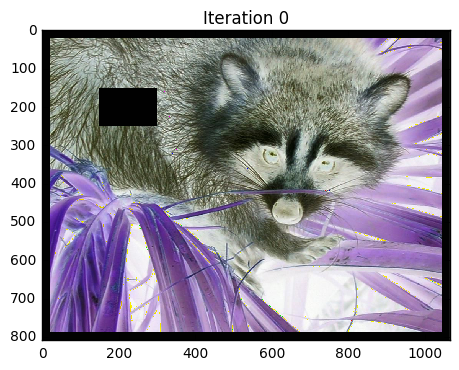

psi = 47


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:69: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


Confidence 0.739248528746
Data 0.272259242027
Priority 0.201267244106


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:51: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


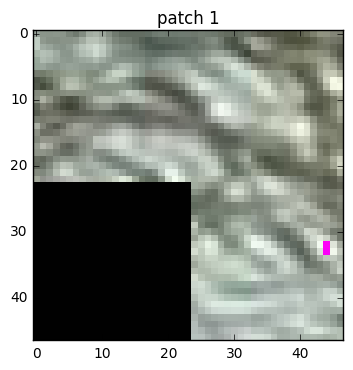

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:59: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


*** Main thread waiting
The queue size is 120000
The queue size is 100000
The queue size is 80000The queue size is 80000

The queue size is 20000The queue size is 19999

The queue size is 0*** Done



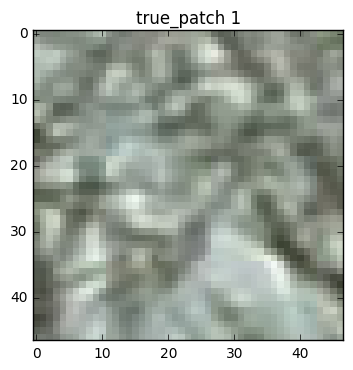

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:90: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


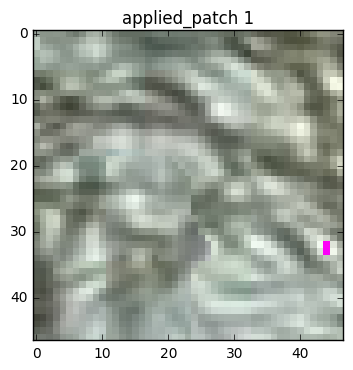

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:106: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:110: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


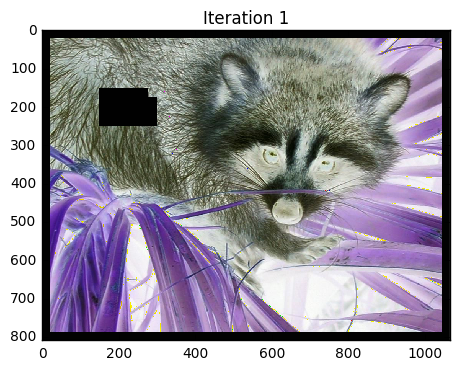

psi = 17
Confidence 0.750865051903
Data 0.226306527682
Priority 0.169925662654


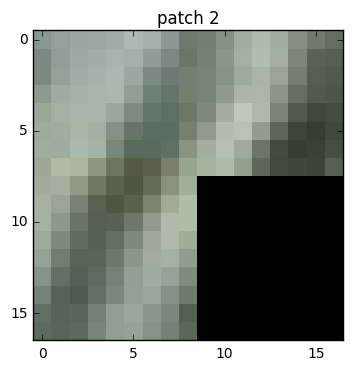

*** Main thread waiting
The queue size is 100000The queue size is 99999

The queue size is 80000
The queue size is 80000The queue size is 80000The queue size is 80000


The queue size is 60000
The queue size is 40000The queue size is 40000The queue size is 40000


The queue size is 20000
The queue size is 0The queue size is 0

*** Done


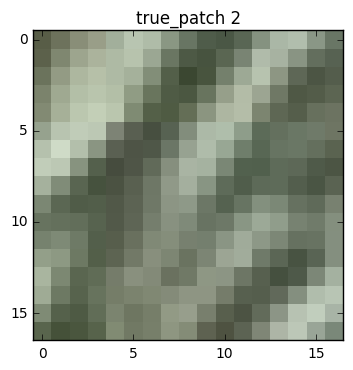

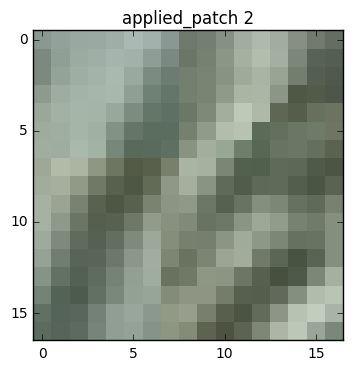

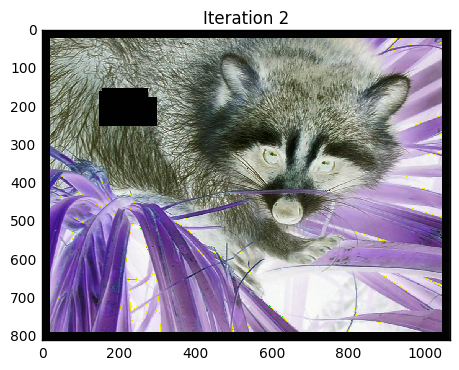

psi = 35
Confidence 0.632653061224
Data 0.337558905955
Priority 0.213557675196


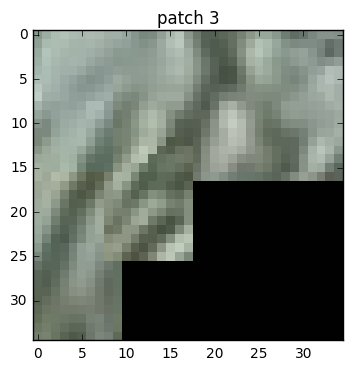

*** Main thread waiting
The queue size is 80000
The queue size is 20000The queue size is 19999

The queue size is 0
*** Done


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:85: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


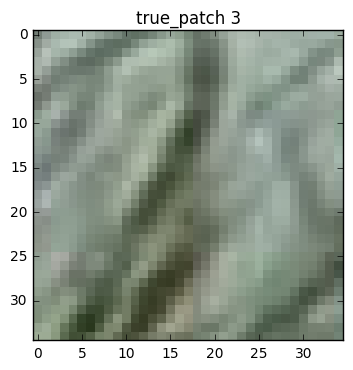

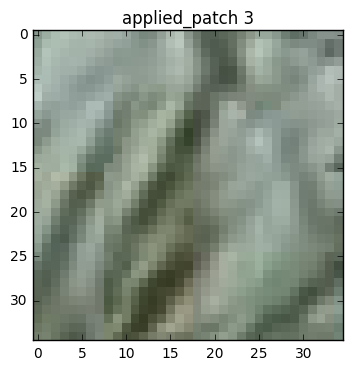

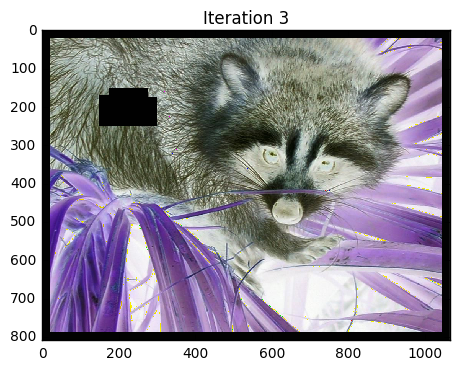

psi = 29
Confidence 0.732461355529
Data 0.215399021742
Priority 0.157771459445


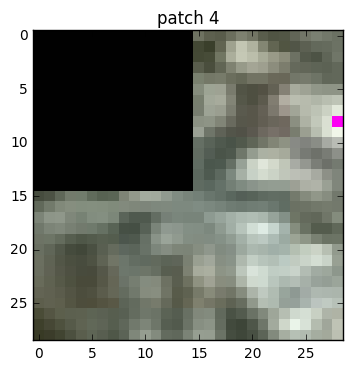

*** Main thread waiting
The queue size is 160000
The queue size is 140000
The queue size is 120000The queue size is 120000

The queue size is 100000The queue size is 100000

The queue size is 80000The queue size is 80000The queue size is 80000The queue size is 80000



The queue size is 59999
The queue size is 40000
The queue size is 0
*** Done


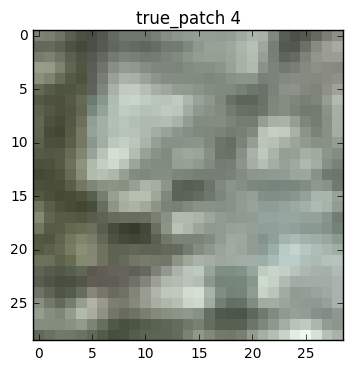

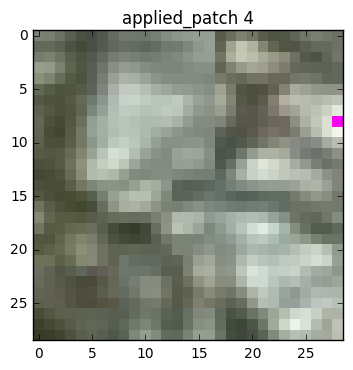

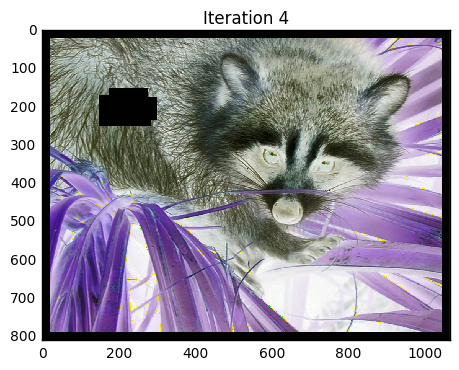

psi = 47
Confidence 0.597352523376
Data 0.250448694559
Priority 0.149606159671


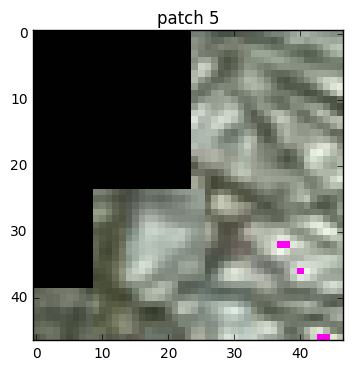

*** Main thread waiting
The queue size is 140000
The queue size is 80000
The queue size is 60000
The queue size is 40000
The queue size is 20000The queue size is 20000

The queue size is 0
*** Done


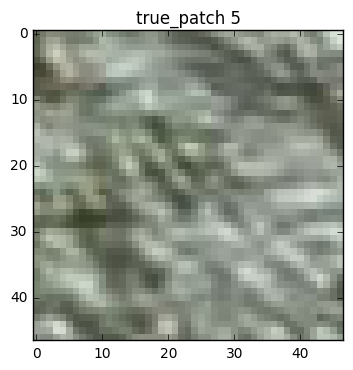

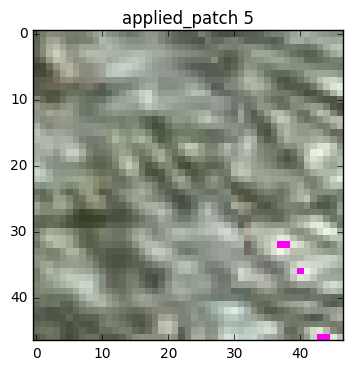

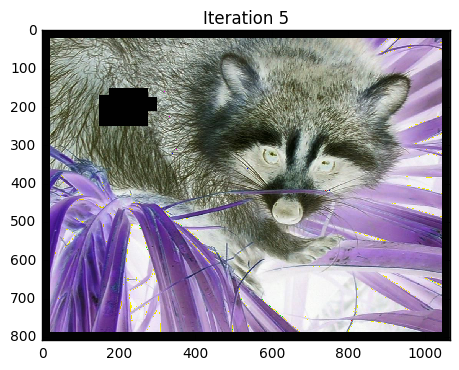

psi = 23
Confidence 0.616308434048
Data 0.192674764519
Priority 0.118747082401


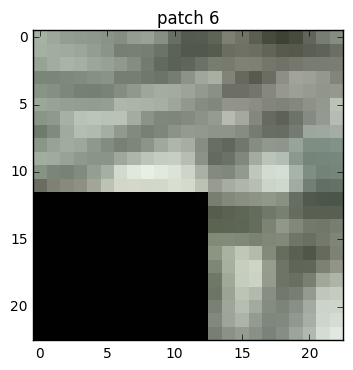

*** Main thread waiting
The queue size is 120000
The queue size is 40000
The queue size is 0The queue size is 0The queue size is 0


*** Done


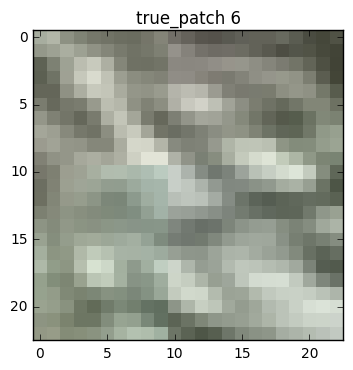

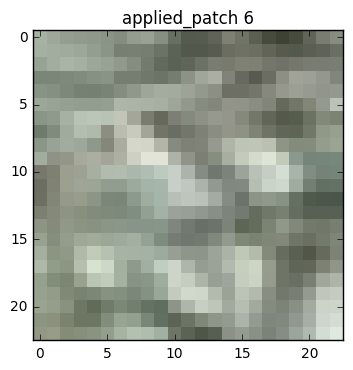

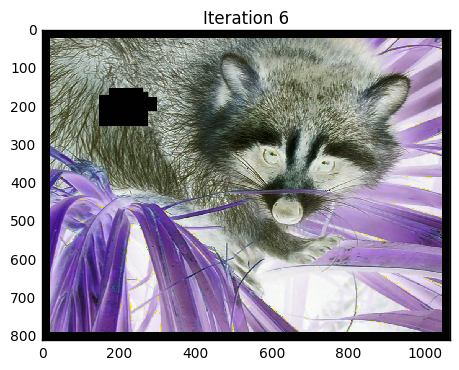

psi = 27
Confidence 0.490305562866
Data 0.241063697399
Priority 0.11819487184


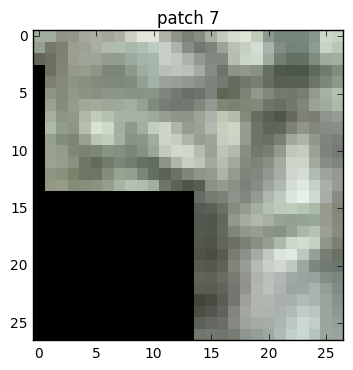

*** Main thread waiting
The queue size is 100000
The queue size is 80000
The queue size is 59998
The queue size is 20000
The queue size is 0
*** Done


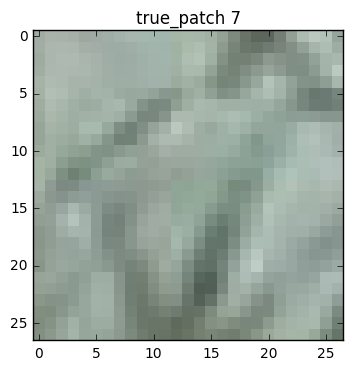

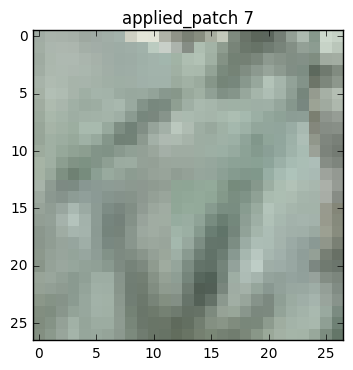

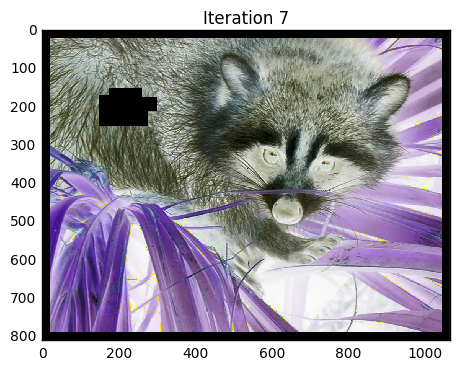

psi = 15
Confidence 0.612043659776
Data 0.170590602964
Priority 0.104408896962


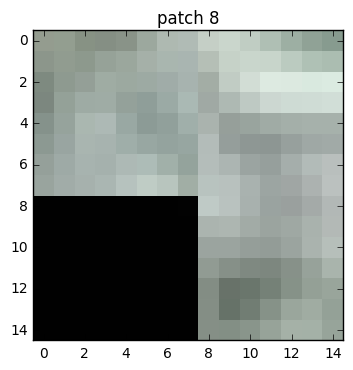

*** Main thread waiting
The queue size is 100000The queue size is 100000The queue size is 100000 


The queue size is 100000
The queue size is 40000The queue size is 40000The queue size is 40000The queue size is 40000



The queue size is 20000
The queue size is 0The queue size is 0

*** Done


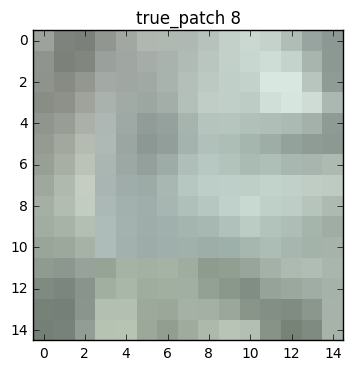

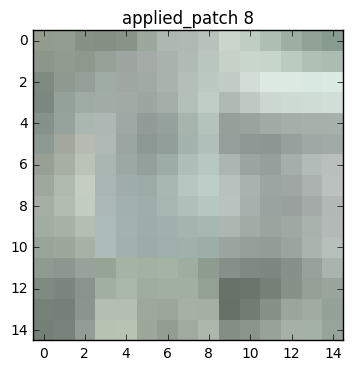

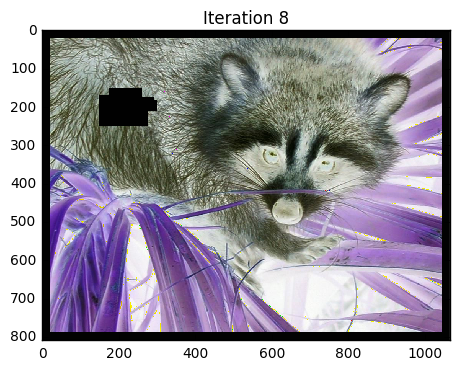

psi = 29
Confidence 0.568753095354
Data 0.179004483536
Priority 0.101809354093


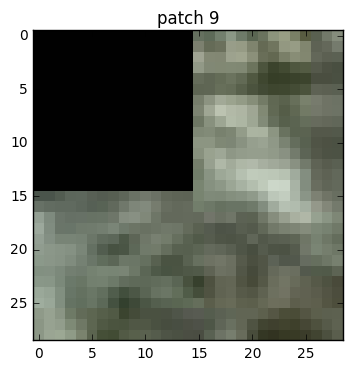

*** Main thread waiting
The queue size is 160000
The queue size is 139999
The queue size is 119999
The queue size is 99999
The queue size is 60000The queue size is 60000

The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


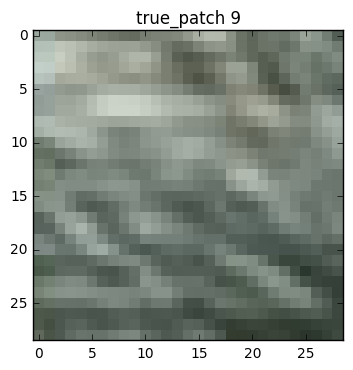

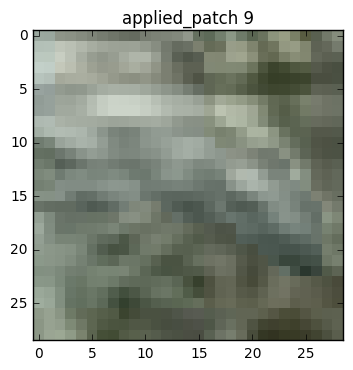

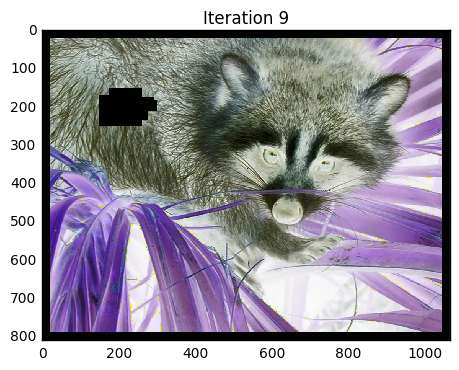

psi = 43
Confidence 0.530264705815
Data 0.219562541321
Priority 0.116426266381


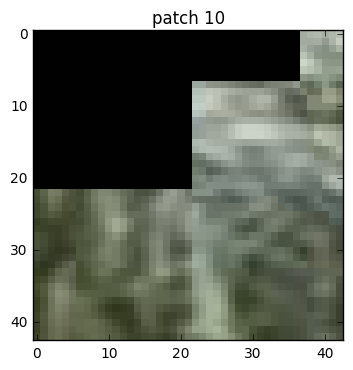

*** Main thread waiting
The queue size is 120000
The queue size is 100000The queue size is 100000

The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


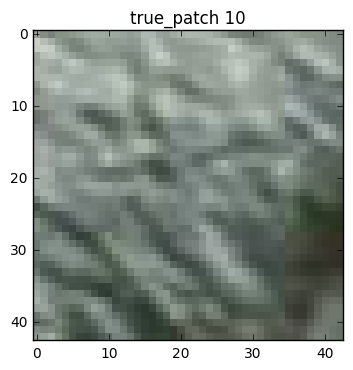

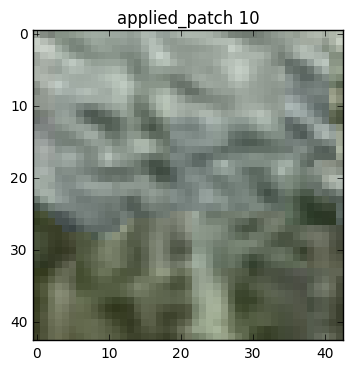

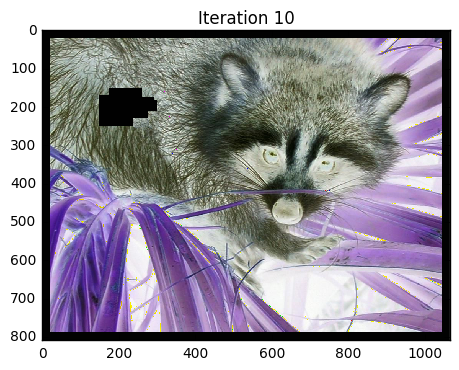

psi = 27
Confidence 0.504969700605
Data 0.262396584954
Priority 0.132502324944


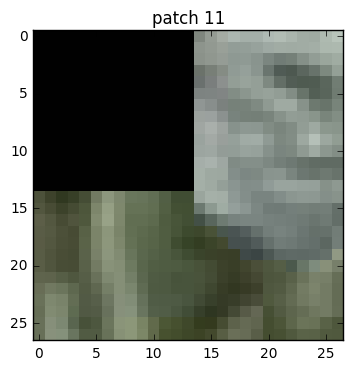

*** Main thread waiting
The queue size is 139999
The queue size is 120000
The queue size is 60000
The queue size is 60000
The queue size is 40000
The queue size is 0
*** Done


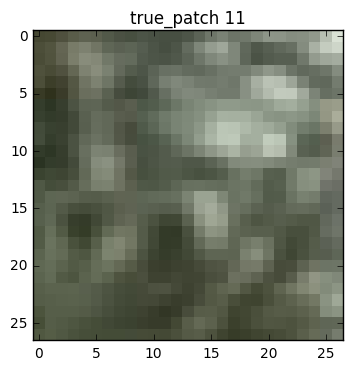

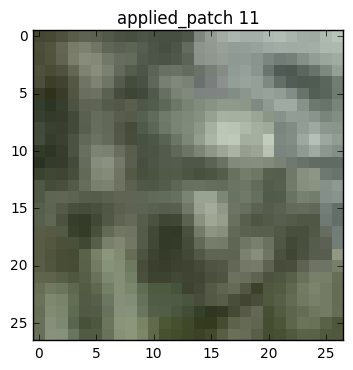

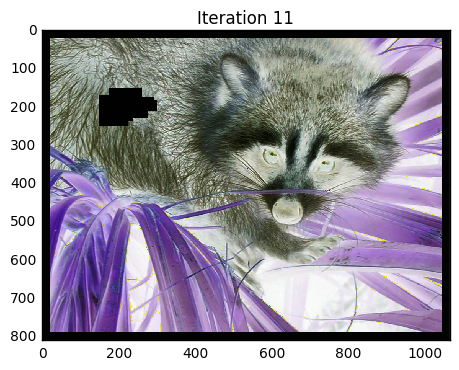

psi = 43
Confidence 0.531457379442
Data 0.192179094025
Priority 0.102134997694


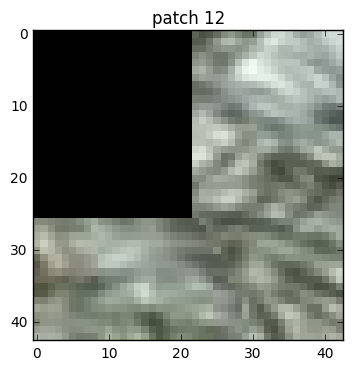

*** Main thread waiting
The queue size is 140000
The queue size is 120000
The queue size is 100000The queue size is 100000

The queue size is 60000The queue size is 59998

The queue size is 40000The queue size is 40000

The queue size is 20000The queue size is 20000
The queue size is 20000The queue size is 20000


The queue size is 0
*** Done


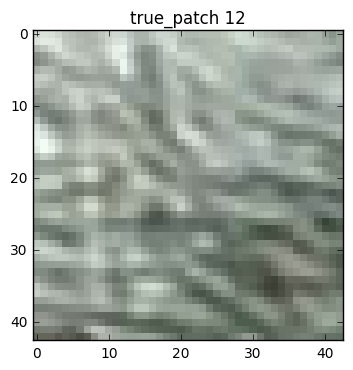

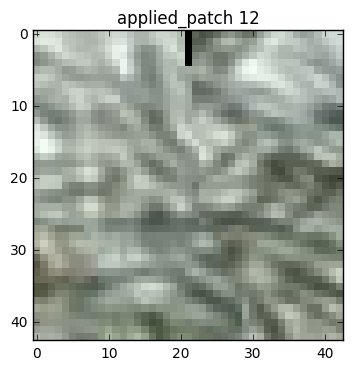

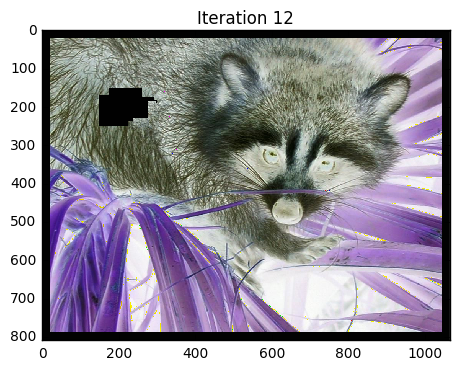

psi = 33
Confidence 0.555322000486
Data 0.194332171781
Priority 0.107916930392


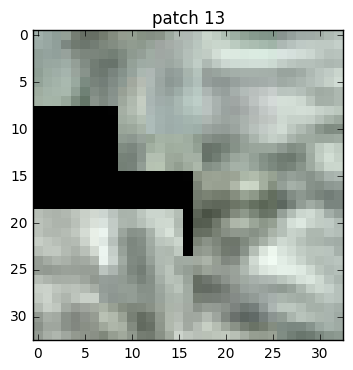

*** Main thread waiting
The queue size is 140000
The queue size is 140000The queue size is 140000

The queue size is 80000The queue size is 80000
The queue size is 80000 The queue size is 80000


The queue size is 60000The queue size is 60000The queue size is 60000The queue size is 60000



The queue size is 40000The queue size is 40000

The queue size is 20000
The queue size is 0
*** Done


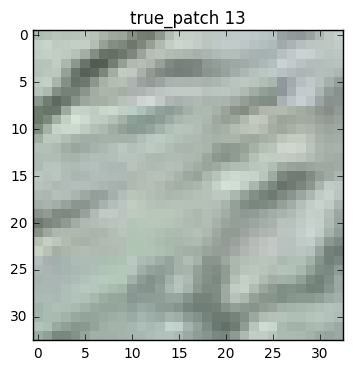

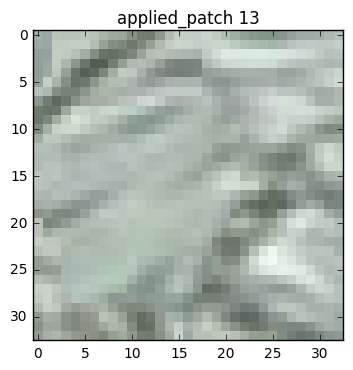

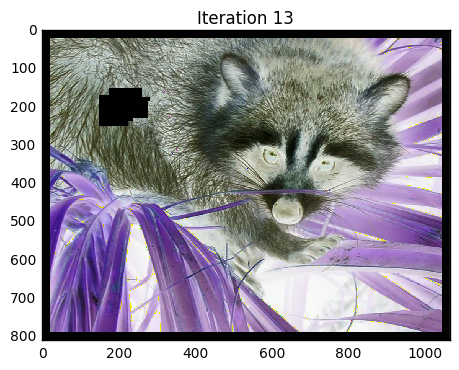

psi = 11
Confidence 0.545454545455
Data 0.192282905225
Priority 0.104881584668


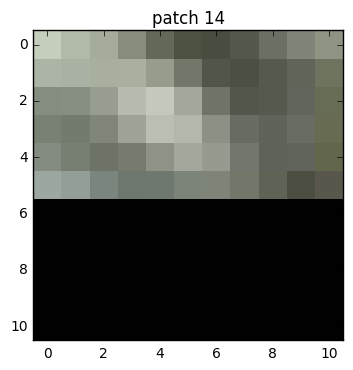

*** Main thread waiting
The queue size is 100000
The queue size is 40000The queue size is 40000

 The queue size is 40000
The queue size is 40000
The queue size is 0
*** Done


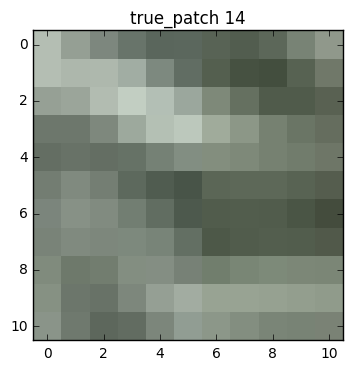

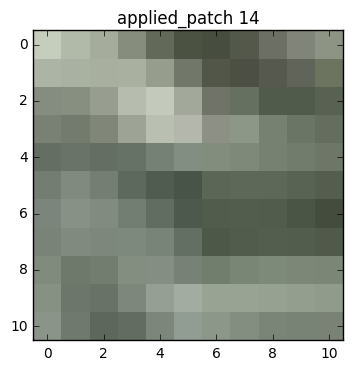

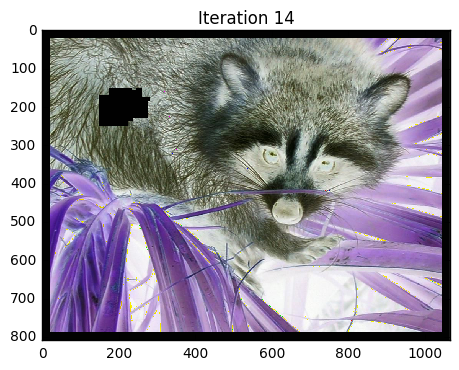

psi = 9
Confidence 0.753086419753
Data 0.13237802457
Priority 0.0996920925771


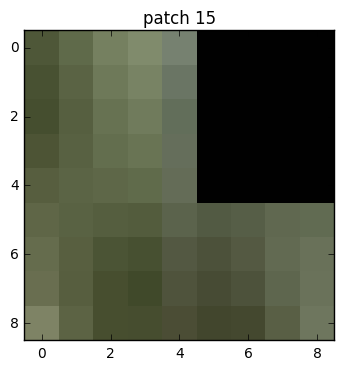

*** Main thread waiting
The queue size is 140000
 The queue size is 139999
The queue size is 100000
The queue size is 20000
The queue size is 0The queue size is 0The queue size is 0The queue size is 0


*** Done



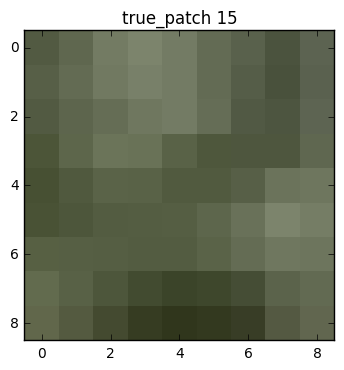

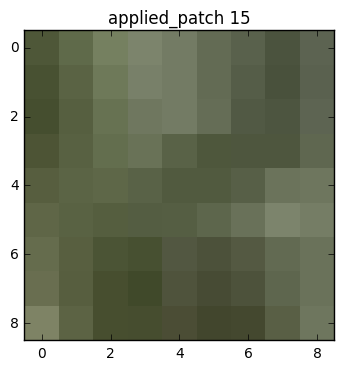

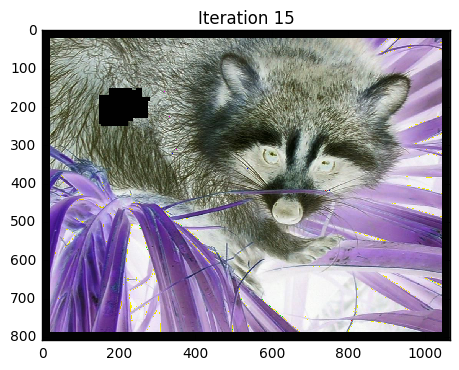

psi = 15
Confidence 0.579682539683
Data 0.15453428429
Priority 0.0895808263851


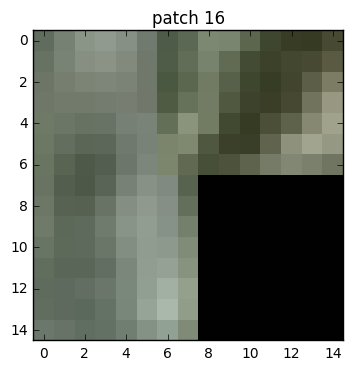

*** Main thread waiting
The queue size is 100000The queue size is 99999
The queue size is 99999

The queue size is 60000The queue size is 60000The queue size is 60000


The queue size is 0The queue size is 0
The queue size is 0
*** Done



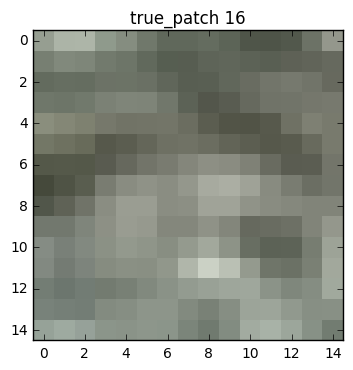

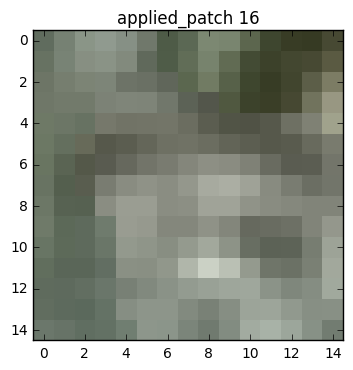

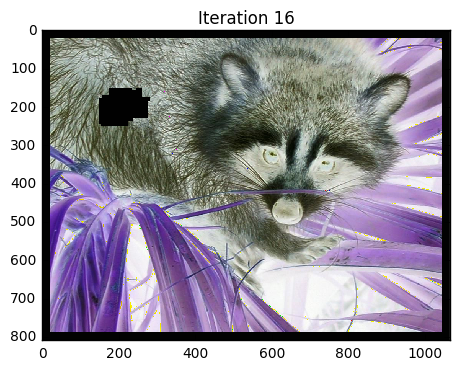

psi = 49
Confidence 0.575771999762
Data 0.178508764989
Priority 0.102780348593


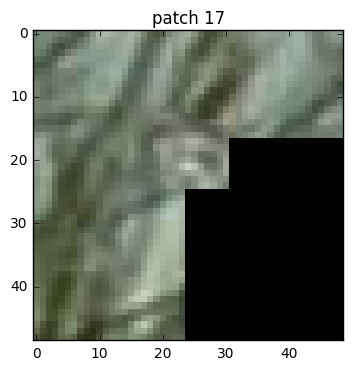

*** Main thread waiting
The queue size is 119999
The queue size is 80000
The queue size is 0The queue size is 0

*** Done


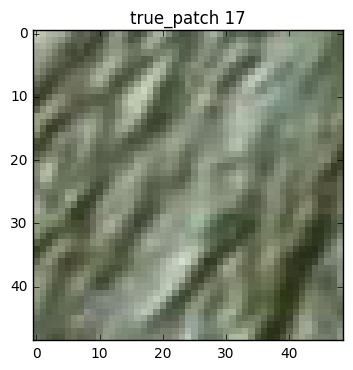

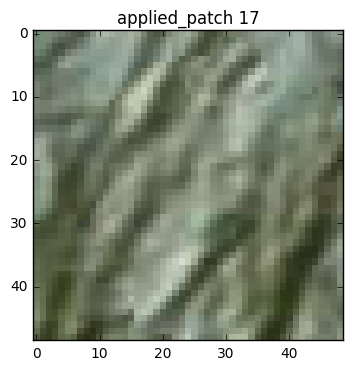

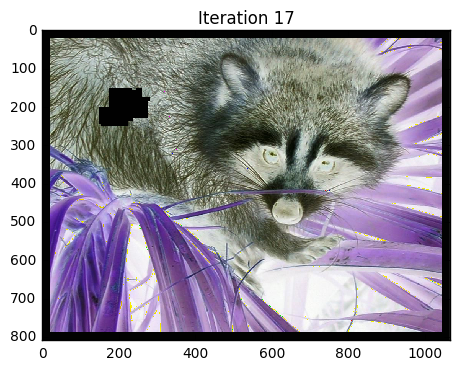

psi = 35
Confidence 0.544150481517
Data 0.156302709806
Priority 0.0850521948036


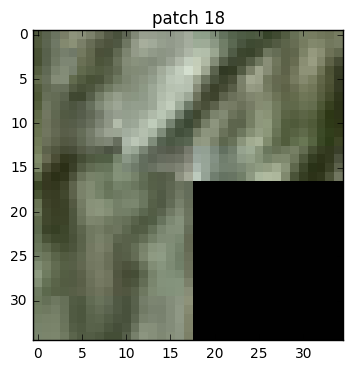

*** Main thread waiting
The queue size is 100000The queue size is 100000
The queue size is 100000
 The queue size is 100000

The queue size is 59999
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


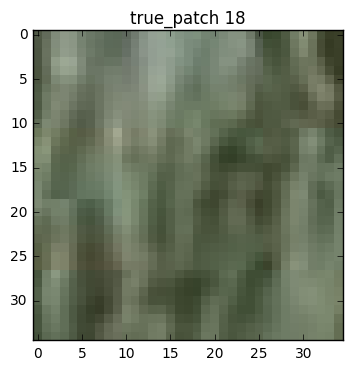

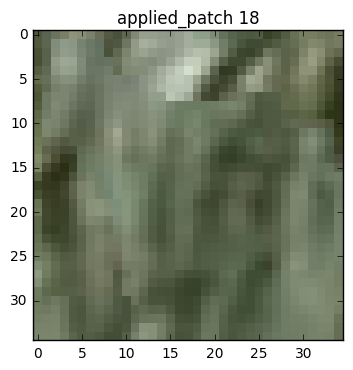

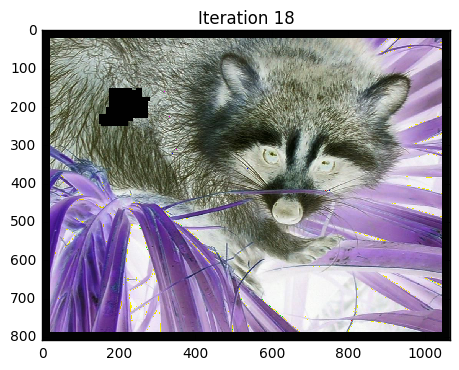

psi = 17
Confidence 0.529411764706
Data 0.154319103718
Priority 0.081698349027


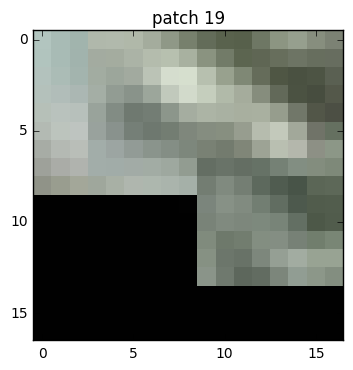

*** Main thread waiting
The queue size is 120000The queue size is 119999The queue size is 119999


The queue size is 100000
The queue size is 79998
The queue size is 60000
The queue size is 40000The queue size is 40000The queue size is 40000 


The queue size is 40000
The queue size is 20000
The queue size is 0The queue size is 0
The queue size is 0*** Done




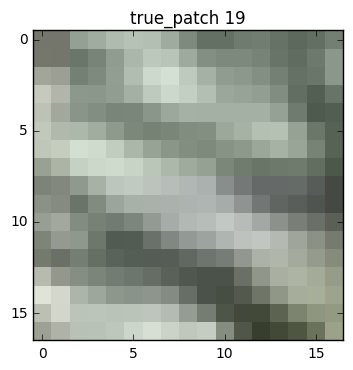

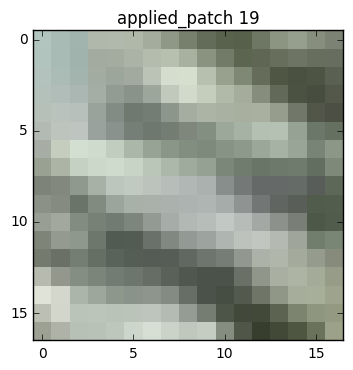

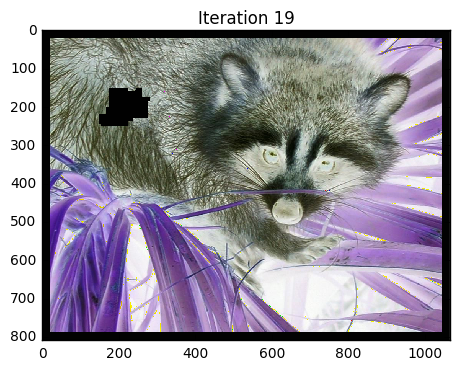

psi = 31
Confidence 0.516129032258
Data 0.182434518211
Priority 0.0941597513347


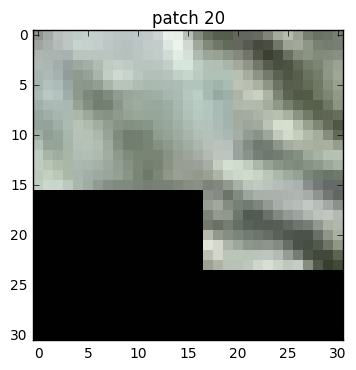

*** Main thread waiting
The queue size is 120000
The queue size is 80000The queue size is 80000The queue size is 80000


The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


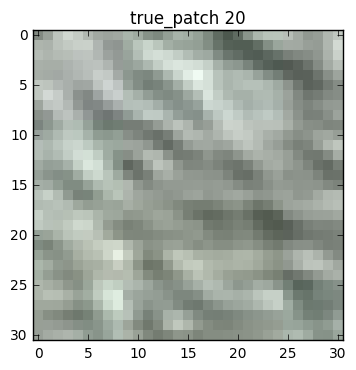

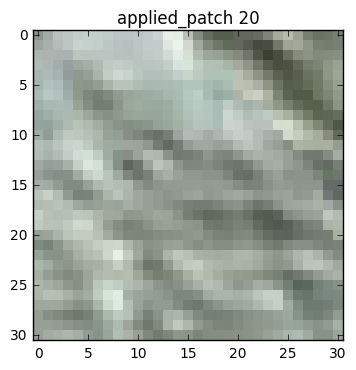

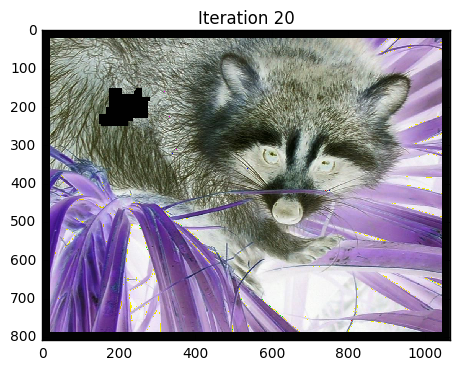

psi = 41
Confidence 0.408443384003
Data 0.24275021976
Priority 0.0991497212263


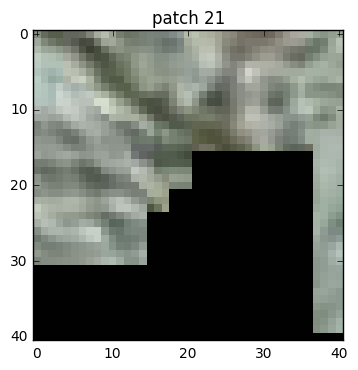

*** Main thread waiting
The queue size is 120000
The queue size is 100000
The queue size is 40000
The queue size is 0
*** Done


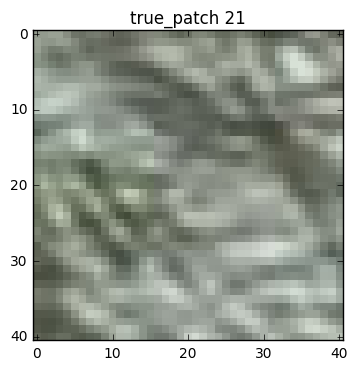

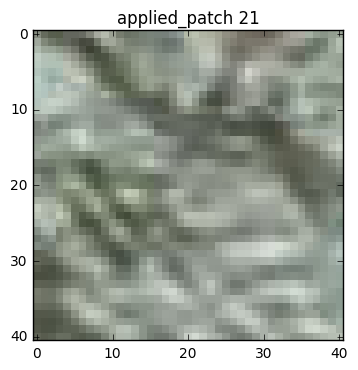

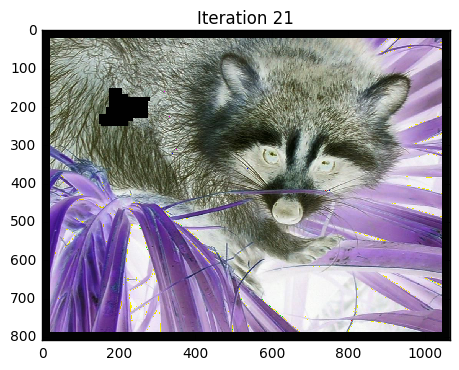

psi = 31
Confidence 0.414194777003
Data 0.201711013457
Priority 0.083547648238


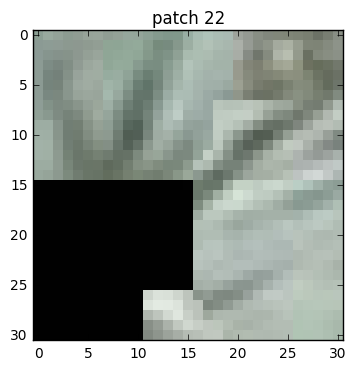

*** Main thread waiting
The queue size is 120000
The queue size is 100000
The queue size is 80000The queue size is 80000The queue size is 80000


The queue size is 60000The queue size is 60000
The queue size is 60000

The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


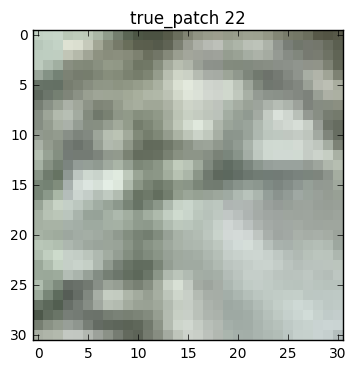

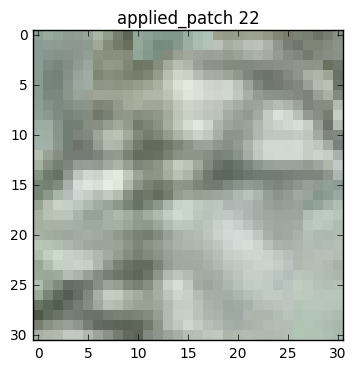

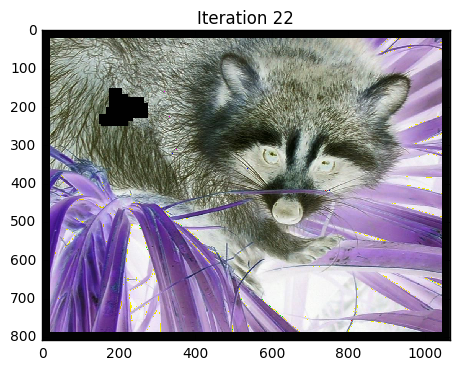

psi = 37
Confidence 0.684441197955
Data 0.113819378792
Priority 0.0779026719707


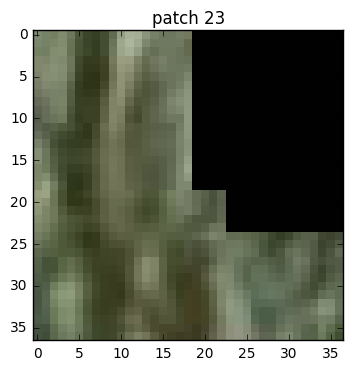

*** Main thread waiting
The queue size is 140000
The queue size is 120000
The queue size is 100000
The queue size is 79999
The queue size is 40000
The queue size is 20000The queue size is 20000

The queue size is 0
*** Done


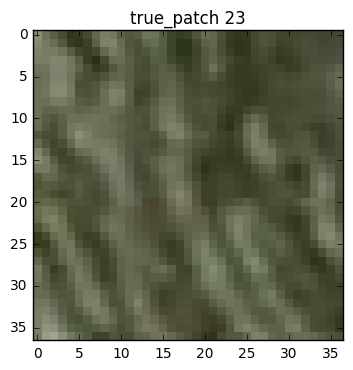

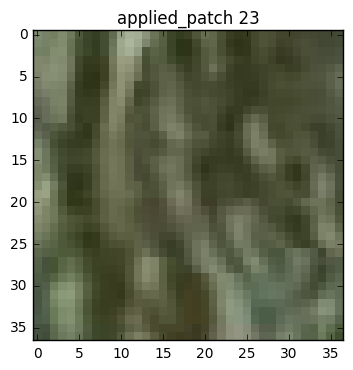

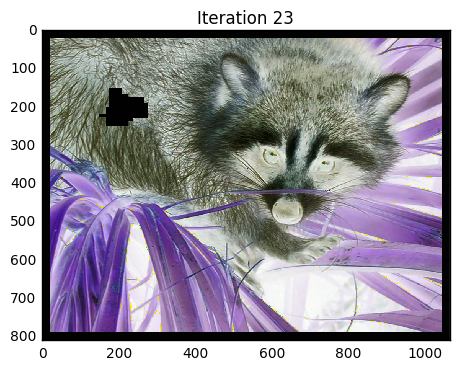

psi = 33
Confidence 0.597793981204
Data 0.159544909947
Priority 0.0953749868978


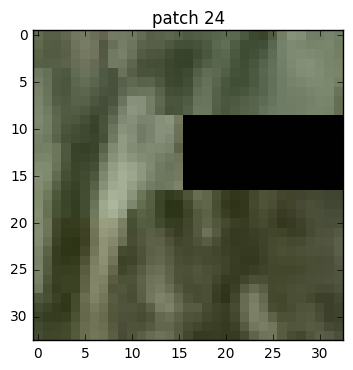

*** Main thread waiting
The queue size is 140000
The queue size is 140000
The queue size is 120000
The queue size is 80000
The queue size is 80000The queue size is 80000

The queue size is 60000
The queue size is 0
*** Done


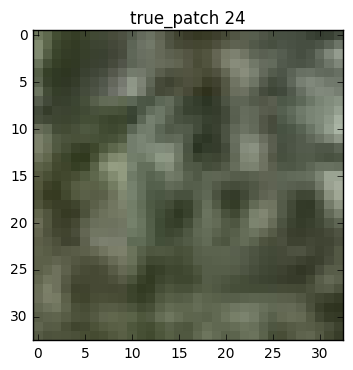

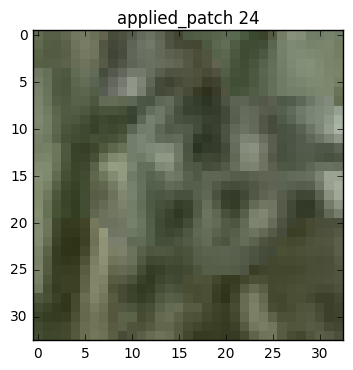

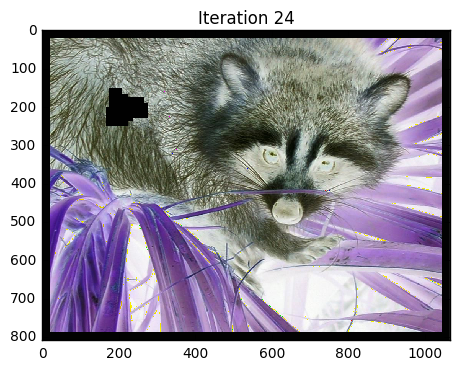

psi = 41
Confidence 0.568972861766
Data 0.141195863631
Priority 0.0803366145996


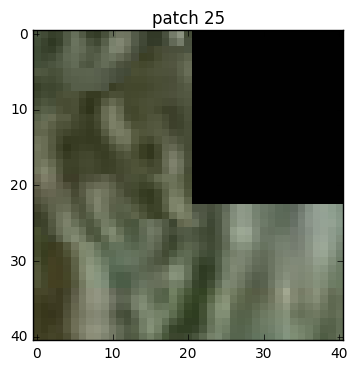

*** Main thread waiting
The queue size is 140000
The queue size is 119999
The queue size is 100000
The queue size is 59999
The queue size is 40000
The queue size is 19999
The queue size is 0
*** Done


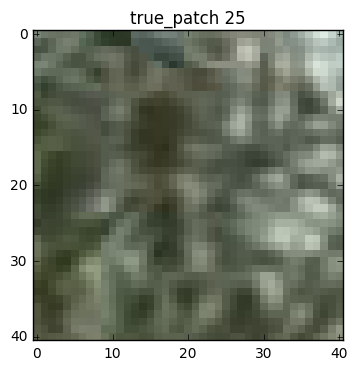

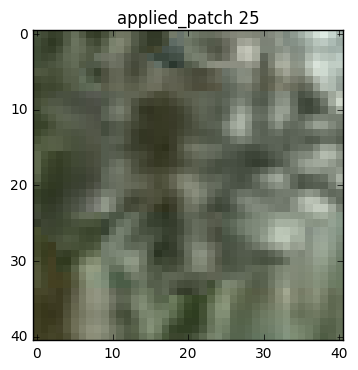

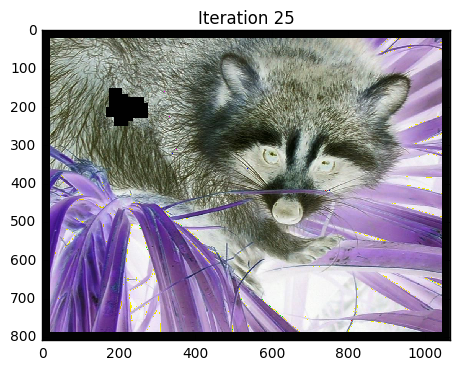

psi = 35
Confidence 0.526154165511
Data 0.186365494675
Priority 0.0980569813305


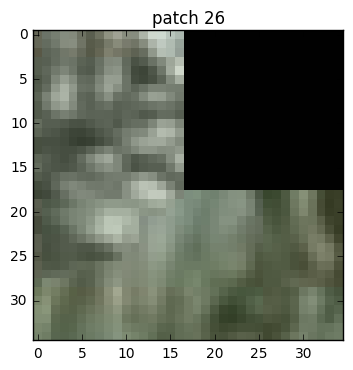

*** Main thread waiting
The queue size is 140000
The queue size is 100000
The queue size is 60000
 The queue size is 59999
The queue size is 20000
The queue size is 0
*** Done


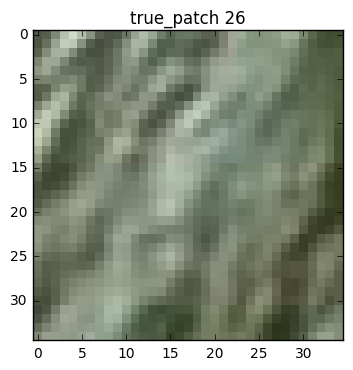

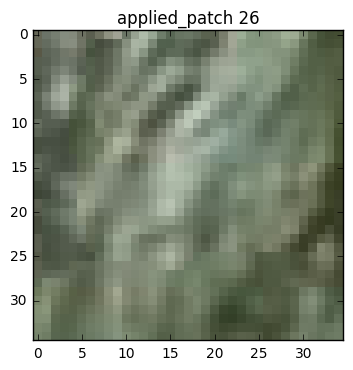

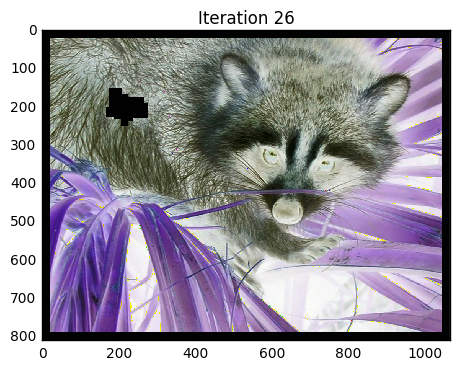

psi = 15
Confidence 0.33404550018
Data 0.25697167267
Priority 0.0858402309291


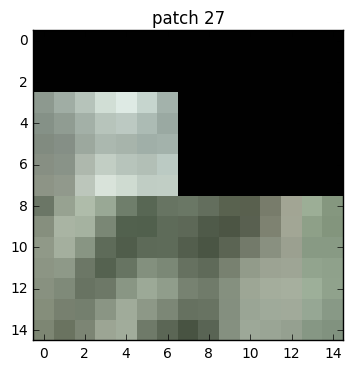

*** Main thread waiting
The queue size is 140000 
The queue size is 139999The queue size is 139999

The queue size is 120000
The queue size is 100000The queue size is 99999

The queue size is 80000
The queue size is 20000The queue size is 20000The queue size is 20000The queue size is 20000



The queue size is 0The queue size is 0The queue size is 0*** Done





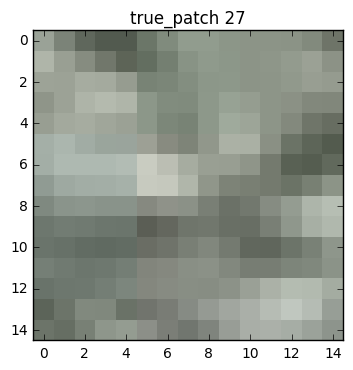

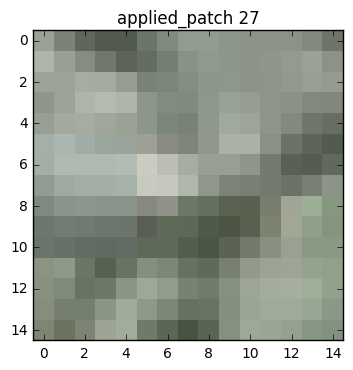

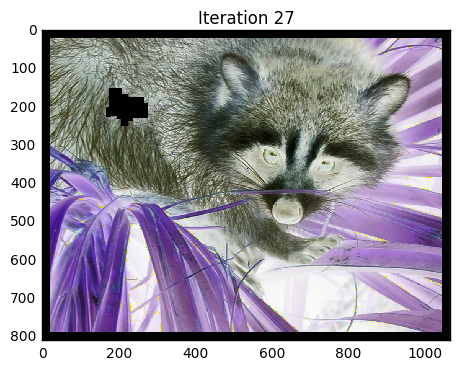

psi = 25
Confidence 0.562060189207
Data 0.127174054531
Priority 0.0714794731518


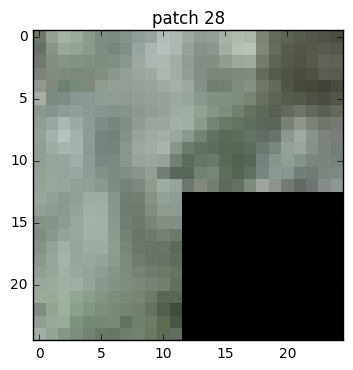

*** Main thread waiting
The queue size is 80000
The queue size is 60000
The queue size is 20000The queue size is 20000

The queue size is 0
*** Done


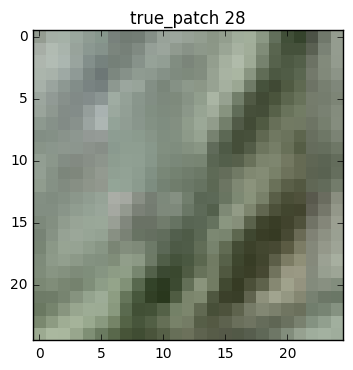

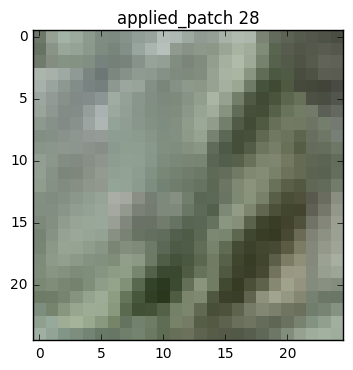

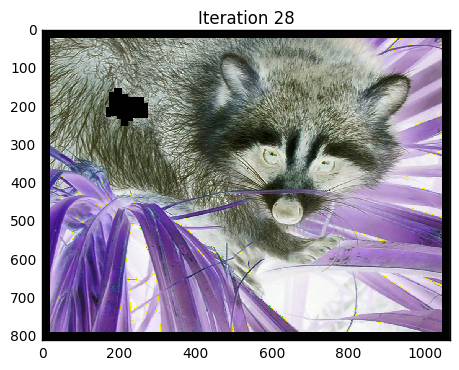

psi = 29
Confidence 0.379907570645
Data 0.19601888829
Priority 0.074469059651


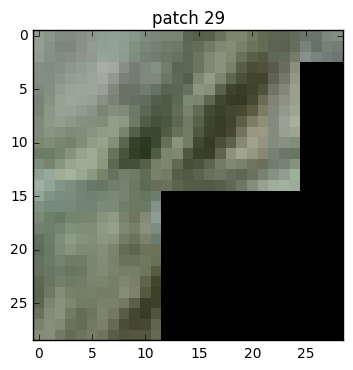

*** Main thread waiting
The queue size is 120000
The queue size is 60000
The queue size is 40000
The queue size is 0The queue size is 0

*** Done


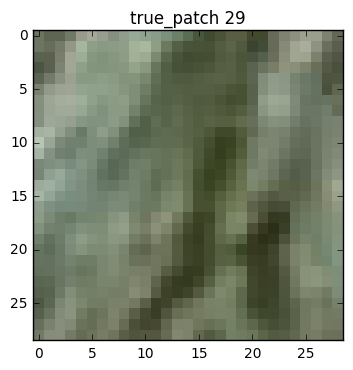

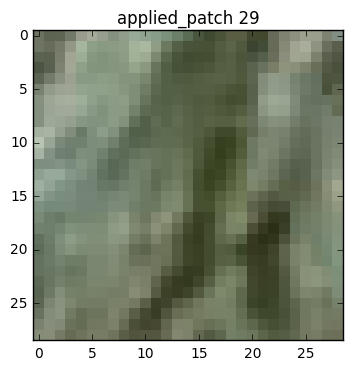

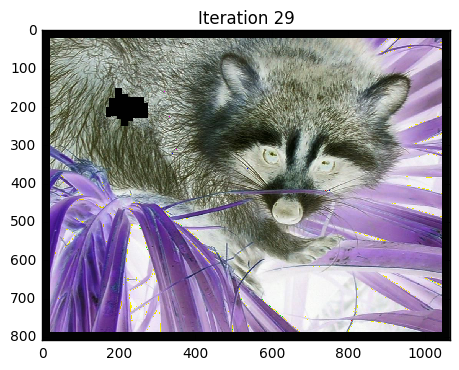

psi = 35
Confidence 0.507611510561
Data 0.176772065887
Priority 0.08973153539


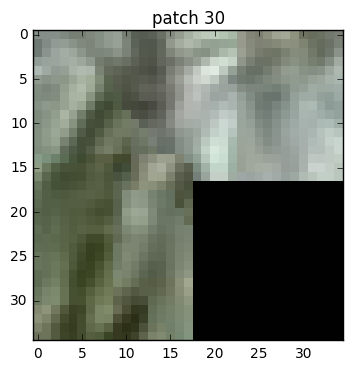

*** Main thread waiting
The queue size is 120000The queue size is 120000

The queue size is 79998
The queue size is 60000
The queue size is 39999
The queue size is 20000
The queue size is 0
*** Done


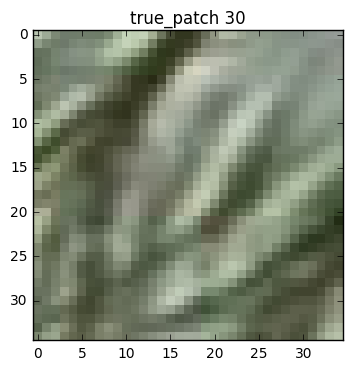

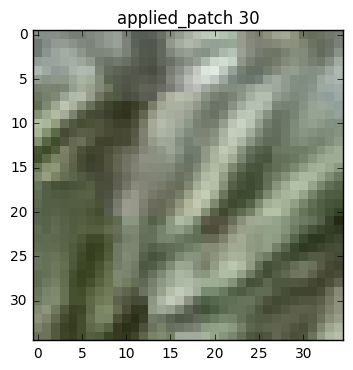

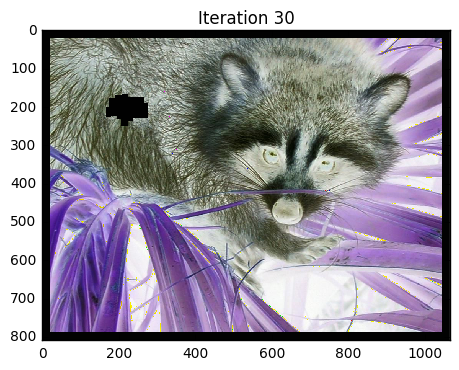

psi = 39
Confidence 0.290507643083
Data 0.285809525531
Priority 0.0830298516325


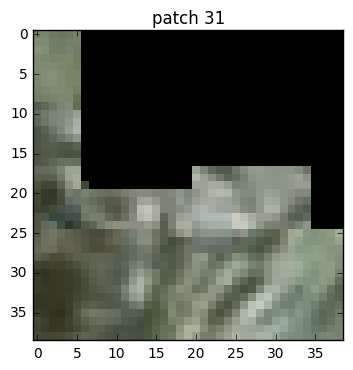

*** Main thread waiting
The queue size is 140000
The queue size is 100000
The queue size is 100000 The queue size is 99999

The queue size is 60000
The queue size is 20000
The queue size is 0The queue size is 0

*** Done


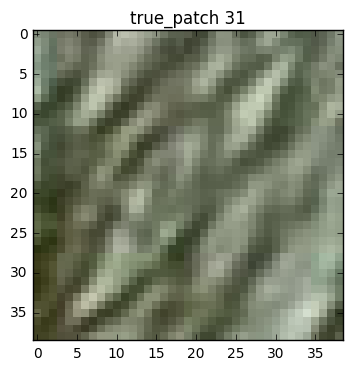

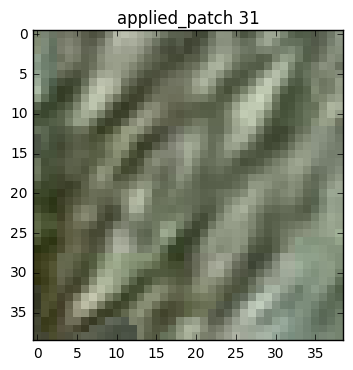

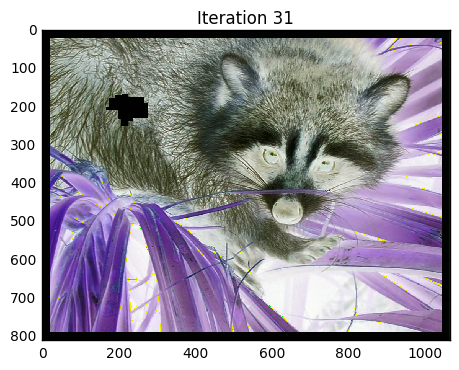

psi = 35
Confidence 0.260817292466
Data 0.269961160046
Priority 0.0704105388341


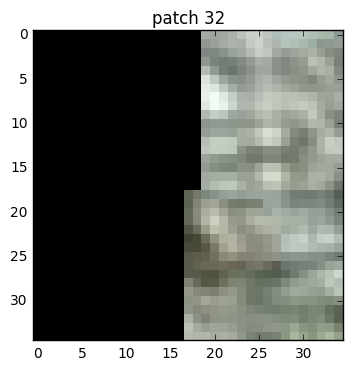

*** Main thread waiting
The queue size is 120000
The queue size is 100000
The queue size is 80000The queue size is 80000
The queue size is 79999

The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


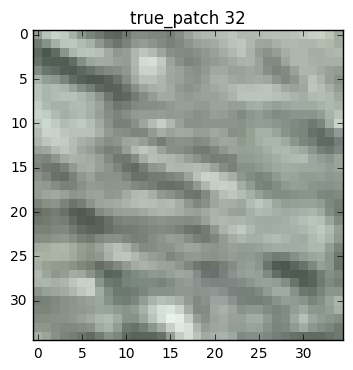

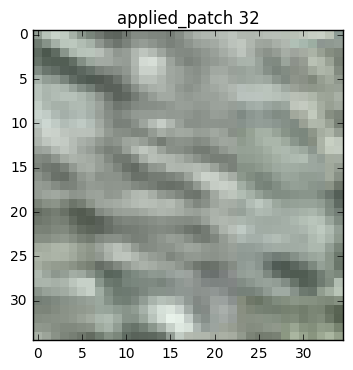

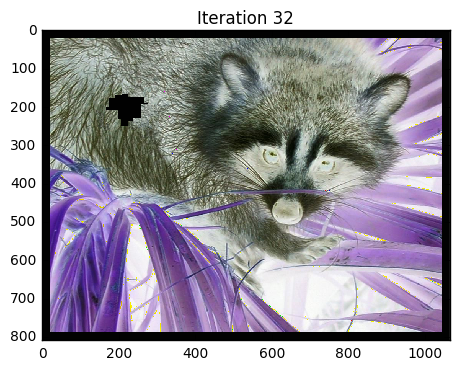

psi = 45
Confidence 0.303278636907
Data 0.230623366875
Priority 0.069943140345


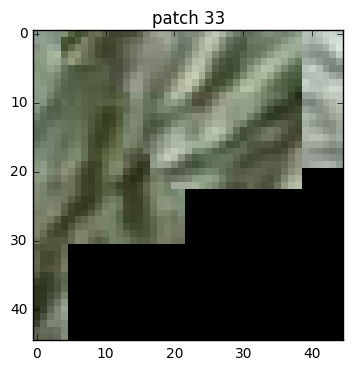

*** Main thread waiting
The queue size is 120000
The queue size is 100000
The queue size is 39999
The queue size is 0
*** Done


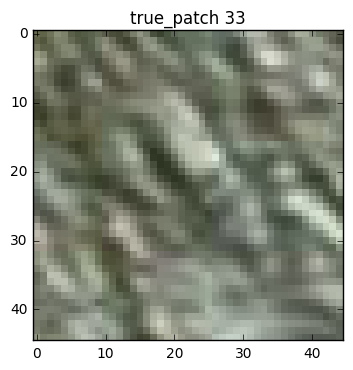

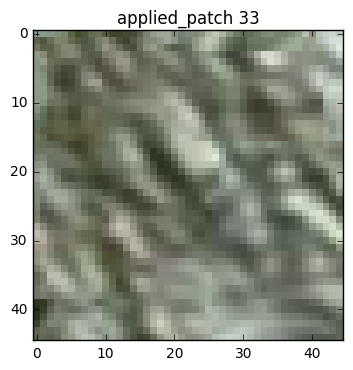

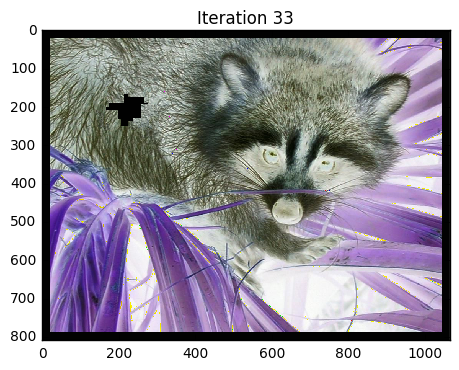

psi = 43
Confidence 0.390751949837
Data 0.181356370477
Priority 0.0708653553792


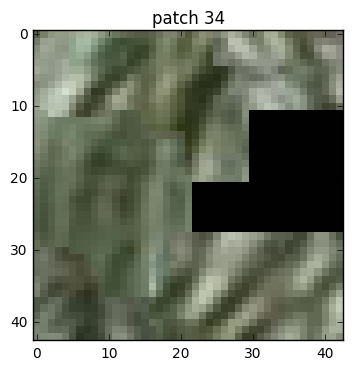

*** Main thread waiting
The queue size is 100000
The queue size is 20000
The queue size is 0
The queue size is 0
*** Done


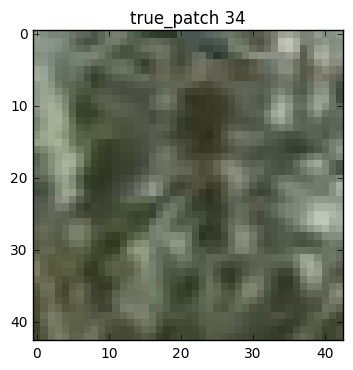

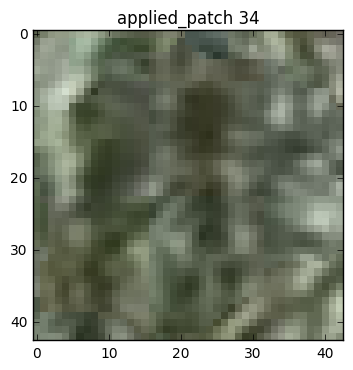

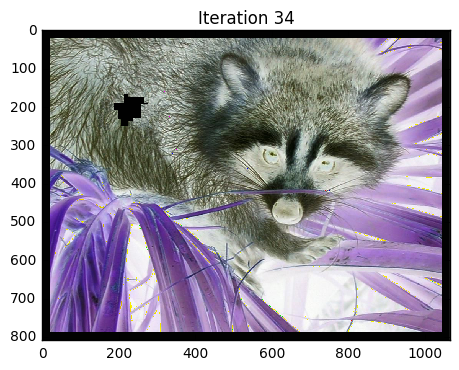

psi = 37
Confidence 0.298326248571
Data 0.2260317947
Priority 0.0674312173707


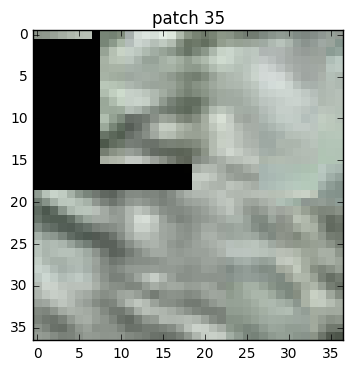

*** Main thread waiting
The queue size is 139999
The queue size is 120000
The queue size is 99999
The queue size is 0
The queue size is 0
*** Done


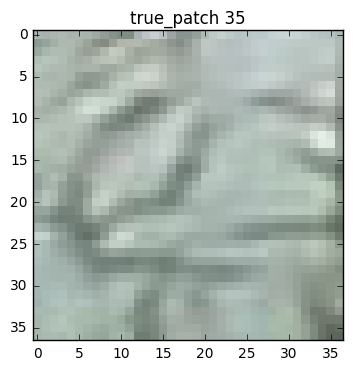

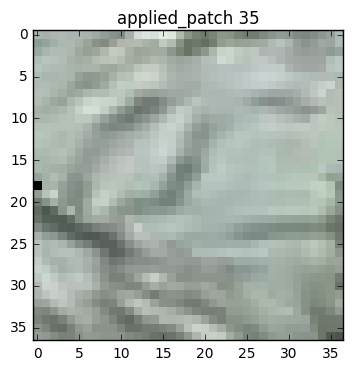

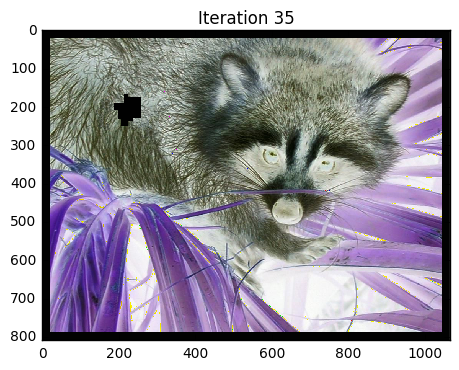

psi = 31
Confidence 0.298642508121
Data 0.206199750575
Priority 0.0615800106858


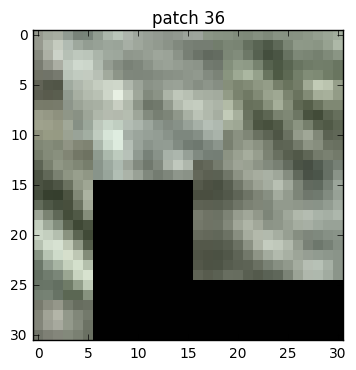

*** Main thread waiting
The queue size is 140000The queue size is 140000
The queue size is 140000

The queue size is 120000
The queue size is 80000The queue size is 80000The queue size is 80000


The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


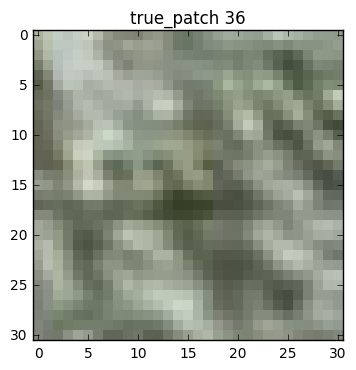

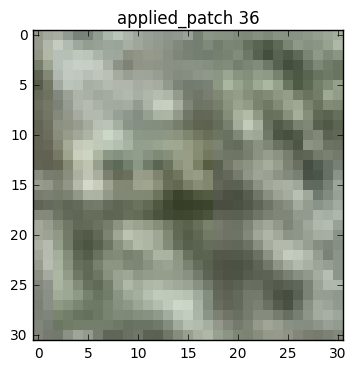

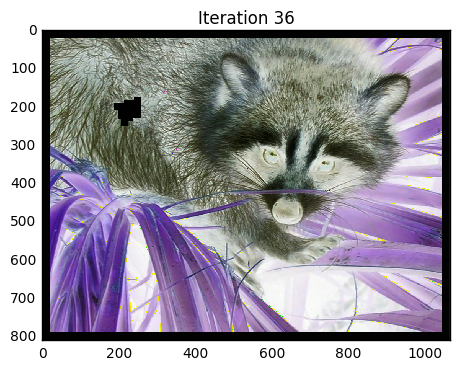

psi = 29
Confidence 0.493315751283
Data 0.121817080983
Priority 0.0600942848244


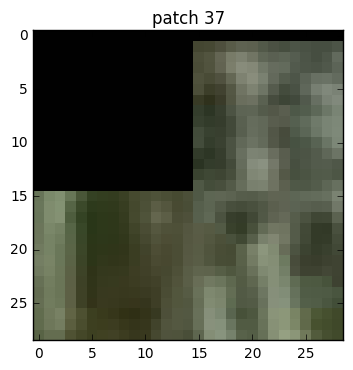

*** Main thread waiting
The queue size is 60000
The queue size is 40000The queue size is 39999

The queue size is 20000
The queue size is 0
*** Done


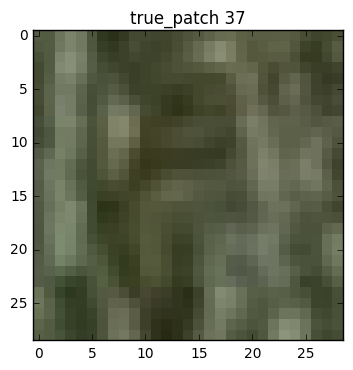

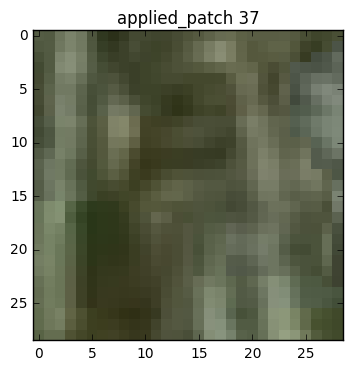

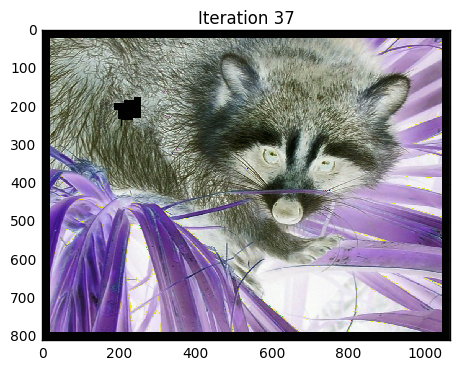

psi = 43
Confidence 0.491758879342
Data 0.211781117014
Priority 0.104145244768


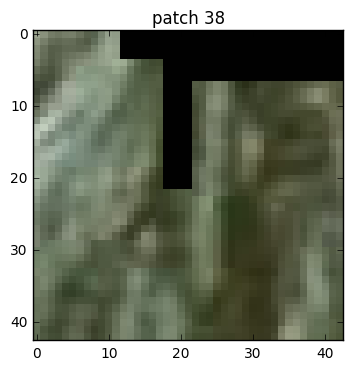

*** Main thread waiting
The queue size is 160000
The queue size is 140000
The queue size is 100000
The queue size is 100000 The queue size is 100000

The queue size is 100000
The queue size is 80000The queue size is 80000The queue size is 80000


The queue size is 59999
The queue size is 0
*** Done


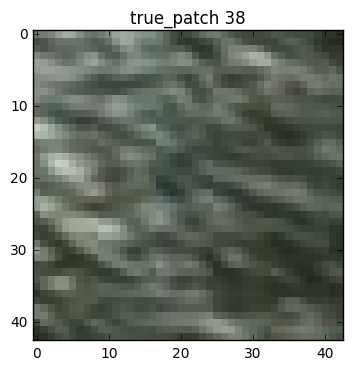

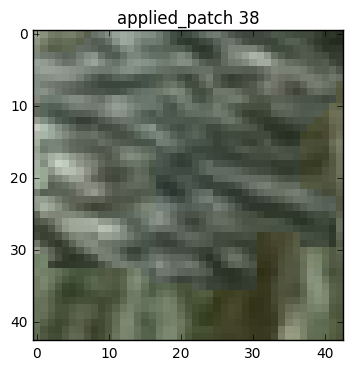

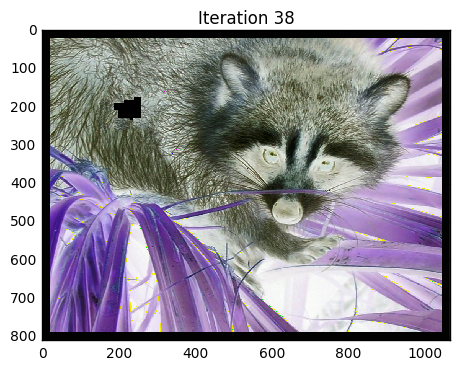

psi = 11
Confidence 0.359158109538
Data 0.235050930204
Priority 0.0844204477372


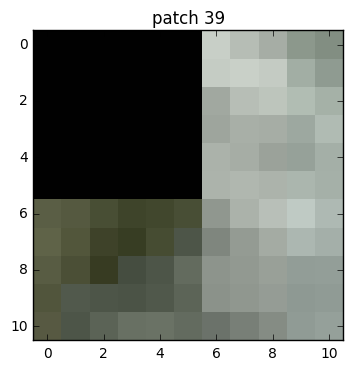

*** Main thread waiting
The queue size is 160000The queue size is 160000

 The queue size is 159999
The queue size is 120000
The queue size is 40000
The queue size is 0The queue size is 0

*** Done


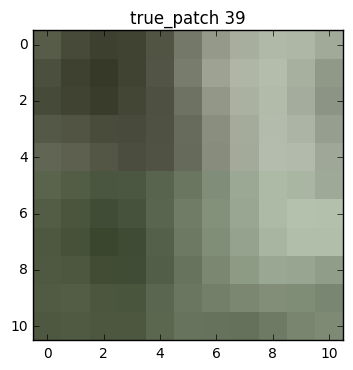

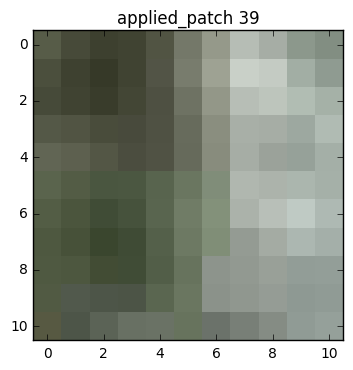

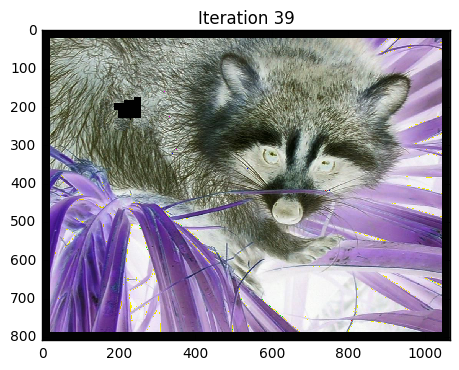

psi = 33
Confidence 0.232132311916
Data 0.258870930947
Priority 0.0600923076886


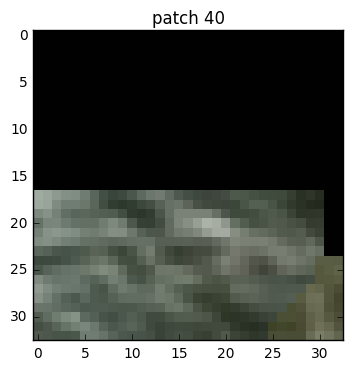

*** Main thread waiting
The queue size is 160000
The queue size is 140000
The queue size is 120000
The queue size is 119999
The queue size is 80000The queue size is 80000
The queue size is 80000

The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0The queue size is 0The queue size is 0


*** Done


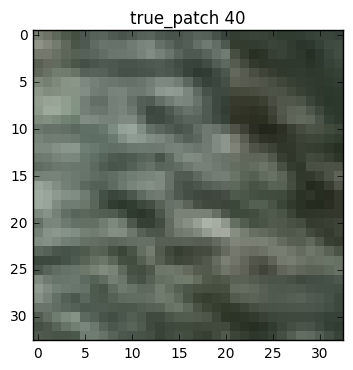

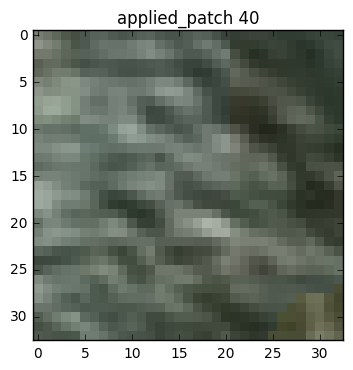

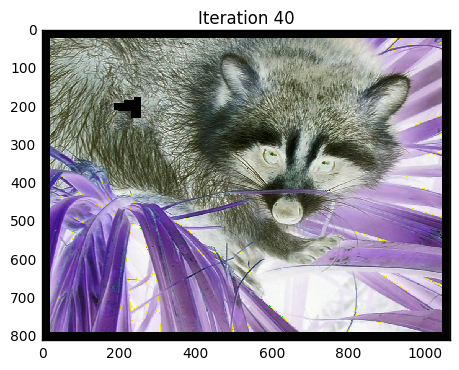

psi = 49
Confidence 0.258892624306
Data 0.231542808741
Priority 0.0599447253942


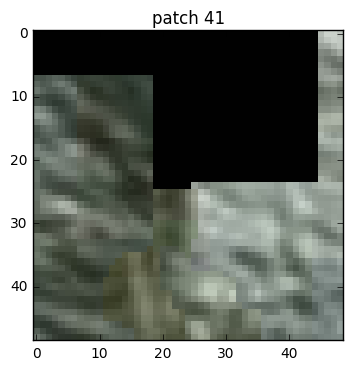

*** Main thread waiting
The queue size is 159998
The queue size is 140000
The queue size is 120000The queue size is 120000

The queue size is 99999
The queue size is 80000
The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


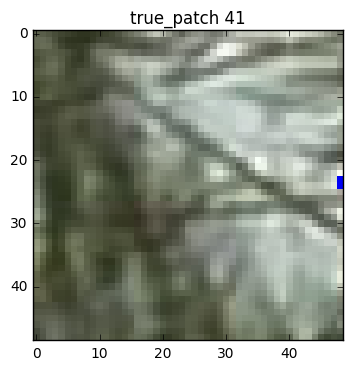

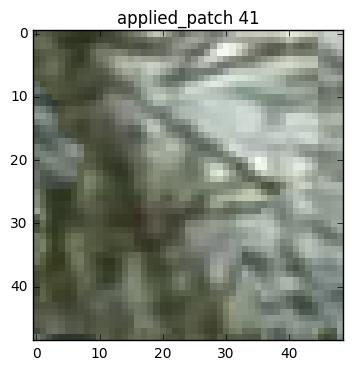

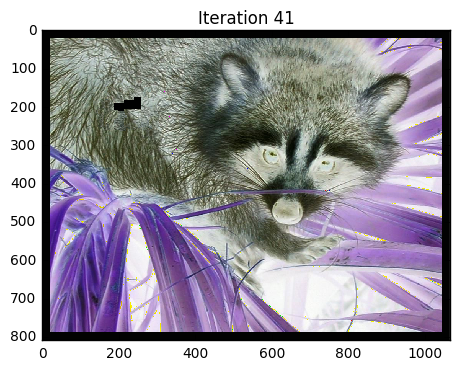

psi = 11
Confidence 0.162723408312
Data 0.307968201342
Priority 0.050113635374


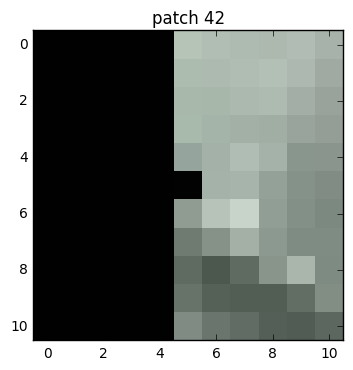

*** Main thread waiting
The queue size is 140000
The queue size is 140000The queue size is 140000

The queue size is 140000
The queue size is 100000 The queue size is 100000
The queue size is 99999

The queue size is 60000The queue size is 60000

The queue size is 0The queue size is 0

The queue size is 0*** Done



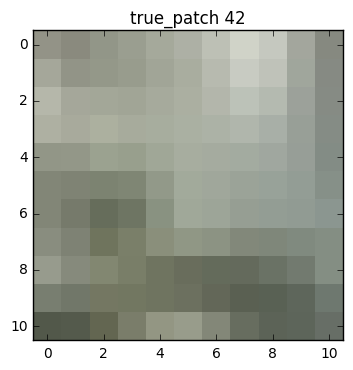

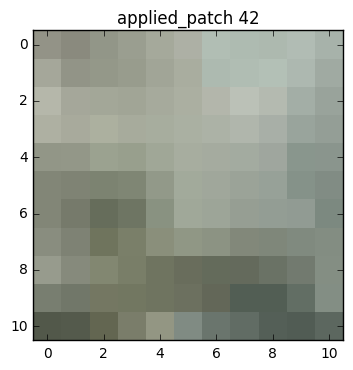

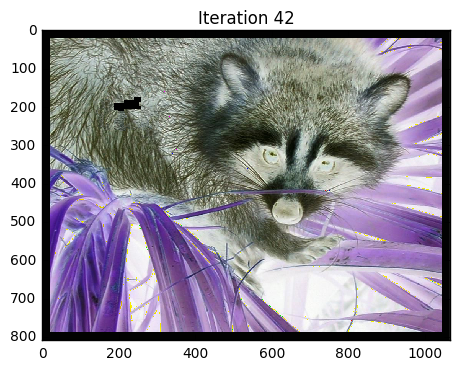

psi = 11
Confidence 0.193273139796
Data 0.249487379471
Priority 0.0482192091698


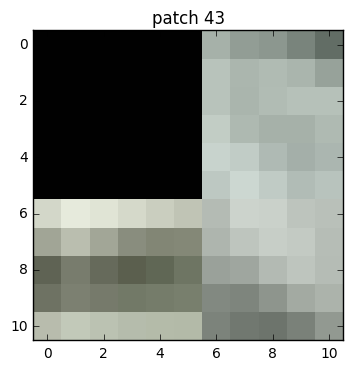

*** Main thread waiting
The queue size is 140000The queue size is 140000
The queue size is 140000
 The queue size is 140000

The queue size is 100000The queue size is 100000
The queue size is 100000

The queue size is 80000
The queue size is 60000The queue size is 60000 
The queue size is 59999

The queue size is 40000
The queue size is 20000The queue size is 20000

The queue size is 0The queue size is 0

*** Done


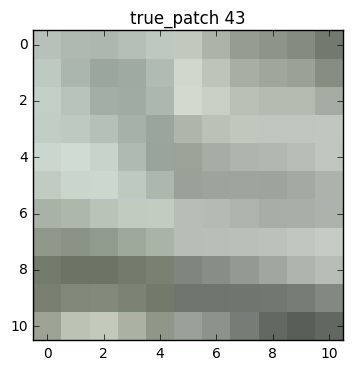

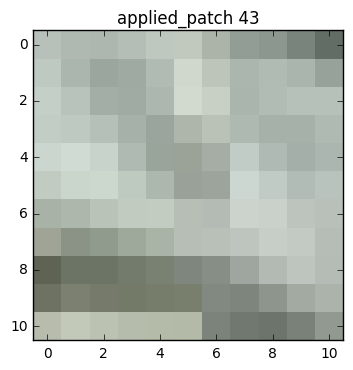

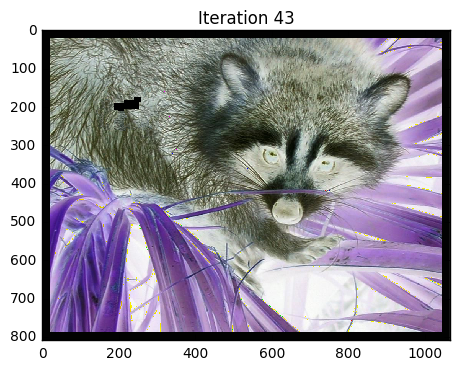

psi = 39
Confidence 0.271619923335
Data 0.167414206869
Priority 0.0454730340351


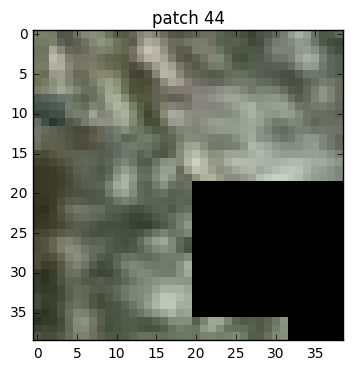

*** Main thread waiting
The queue size is 139999
The queue size is 120000
The queue size is 59998
The queue size is 40000
The queue size is 19999
The queue size is 0
*** Done


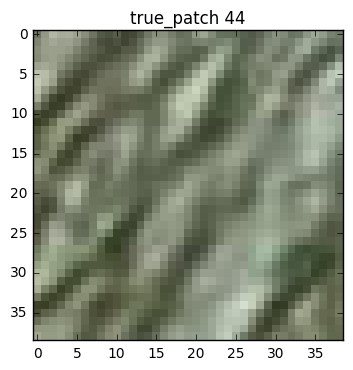

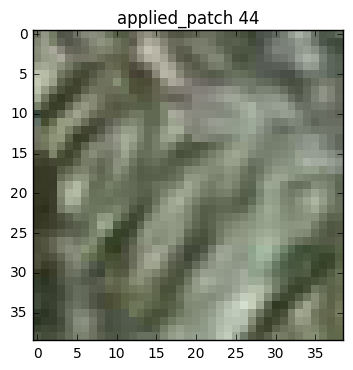

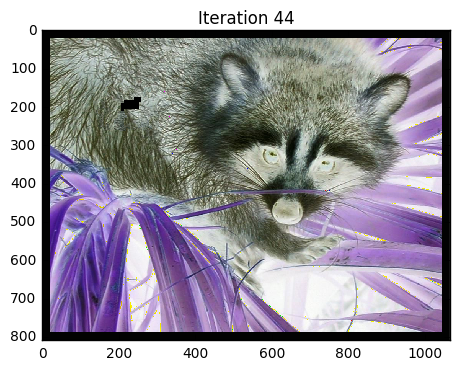

psi = 43
Confidence 0.242903024271
Data 0.2
Priority 0.0485806048542


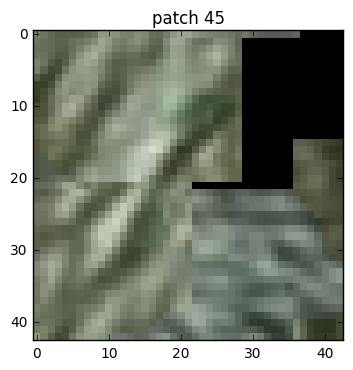

*** Main thread waiting
The queue size is 140000
The queue size is 120000
The queue size is 99999
The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


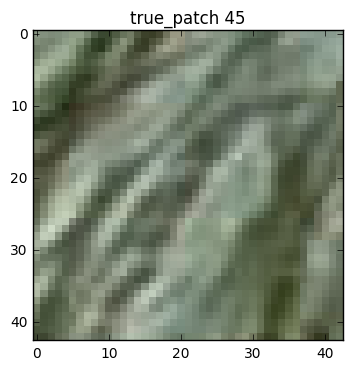

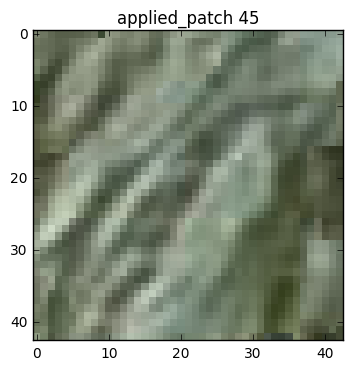

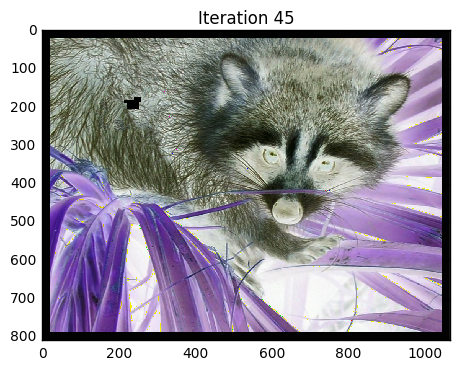

psi = 25
Confidence 0.275362035867
Data 0.146615983093
Priority 0.0403724755952


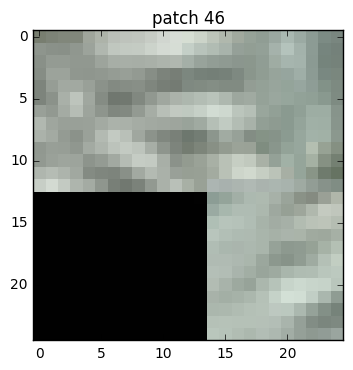

*** Main thread waiting
The queue size is 139999
The queue size is 120000
The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
The queue size is 0
*** Done


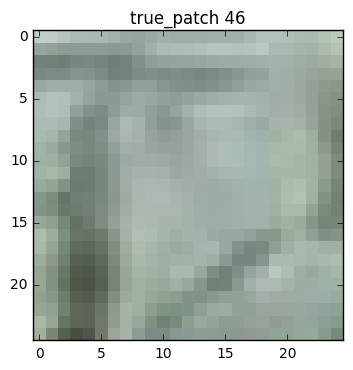

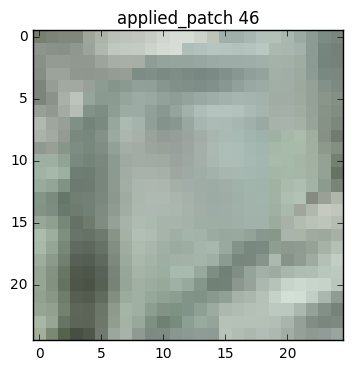

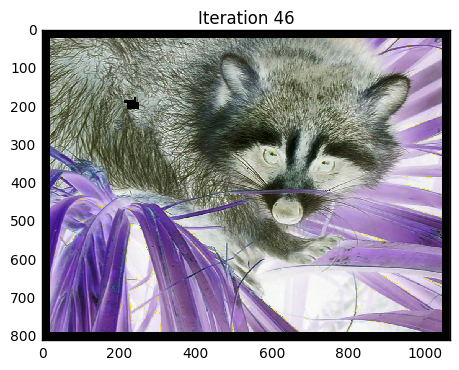

psi = 13
Confidence 0.242005683507
Data 0.194452144961
Priority 0.0470585242507


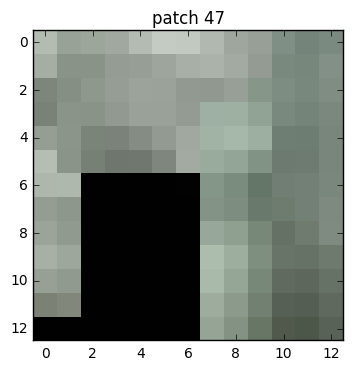

*** Main thread waiting
The queue size is 140000
The queue size is 140000The queue size is 140000

The queue size is 120000The queue size is 120000

The queue size is 100000The queue size is 100000The queue size is 100000


The queue size is 60000The queue size is 59998

The queue size is 40000
The queue size is 0The queue size is 0
*** Done



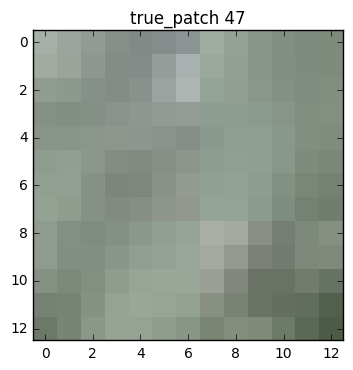

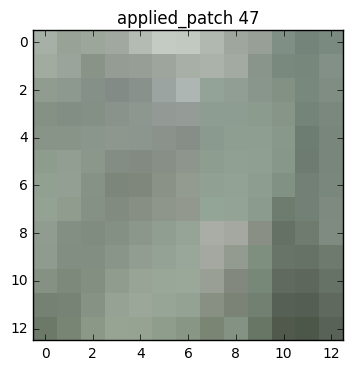

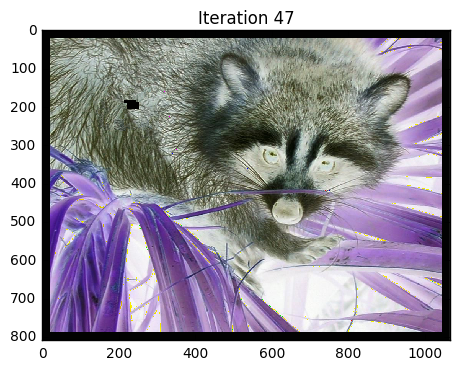

psi = 21
Confidence 0.226952115835
Data 0.162026692763
Priority 0.0367723007443


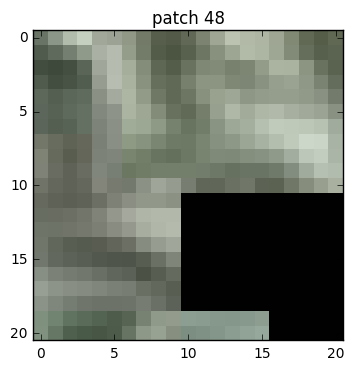

*** Main thread waiting
The queue size is 120000The queue size is 120000

The queue size is 100000
The queue size is 80000
The queue size is 59999
The queue size is 20000
The queue size is 0
*** Done


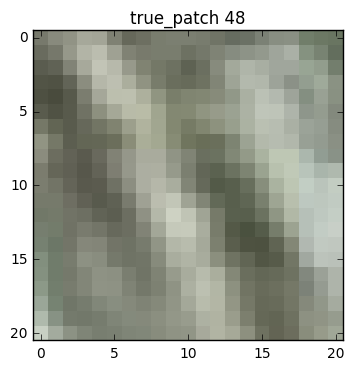

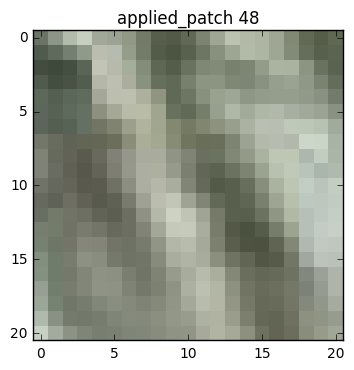

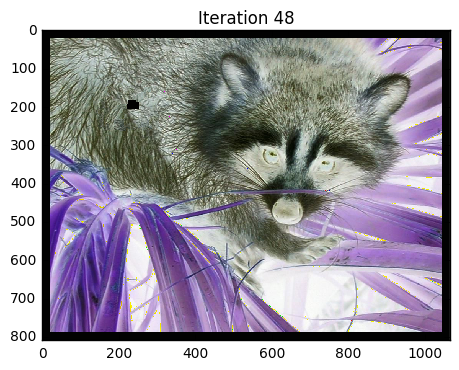

psi = 19
Confidence 0.186456911819
Data 0.188029734556
Priority 0.0350594436354


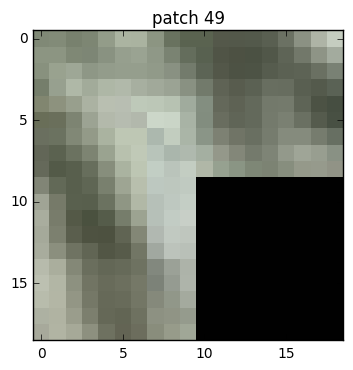

*** Main thread waiting
The queue size is 120000The queue size is 120000

The queue size is 80000
The queue size is 60000The queue size is 60000

The queue size is 40000
The queue size is 20000
The queue size is 0The queue size is 0

*** Done


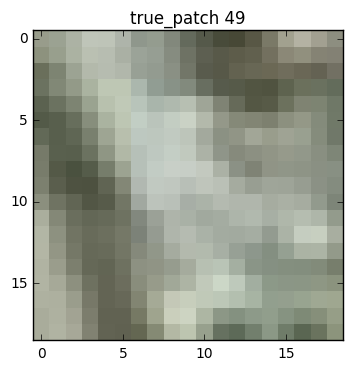

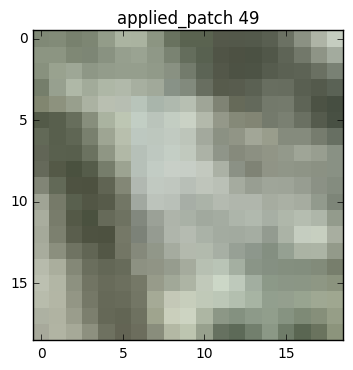

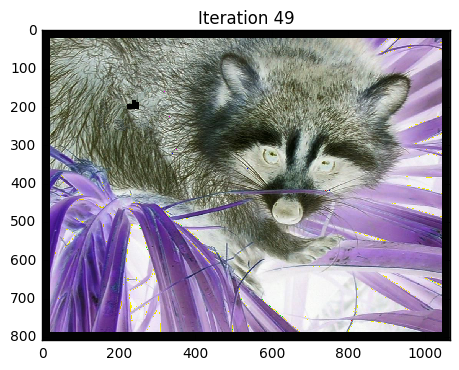

psi = 49
Confidence 0.205657118781
Data 0.221978260145
Priority 0.0456514094134


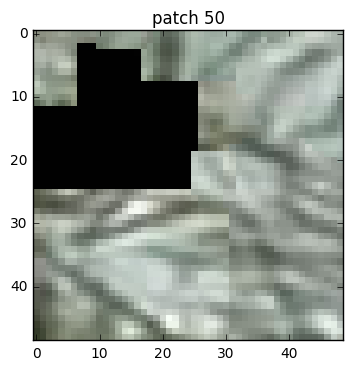

*** Main thread waiting
The queue size is 140000
The queue size is 120000
The queue size is 100000The queue size is 100000

The queue size is 60000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


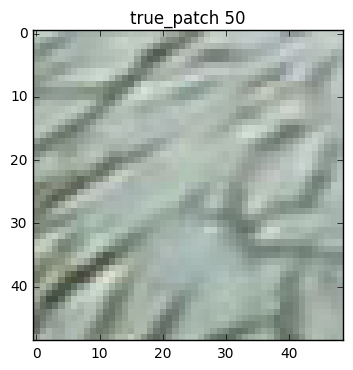

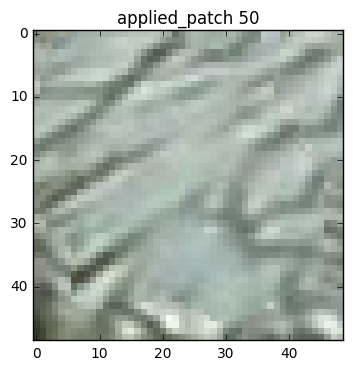

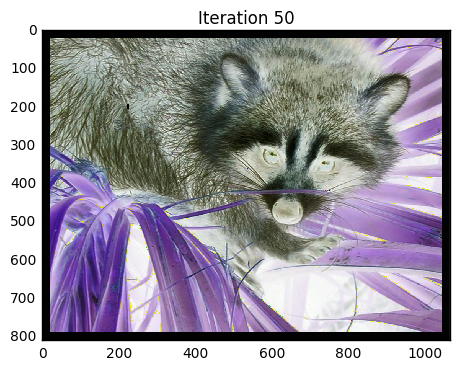

psi = 19
Confidence 0.180950346333
Data 0.240068682307
Priority 0.0434405112071


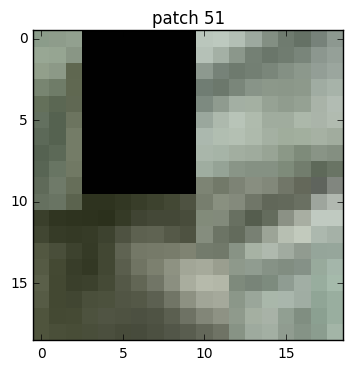

*** Main thread waiting
The queue size is 140000
The queue size is 119999
The queue size is 100000
The queue size is 80000 The queue size is 80000The queue size is 80000
The queue size is 80000


The queue size is 40000
The queue size is 20000
The queue size is 0The queue size is 0
The queue size is 0

*** Done


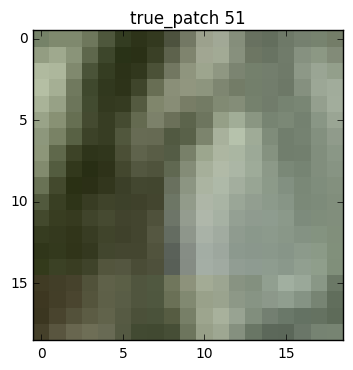

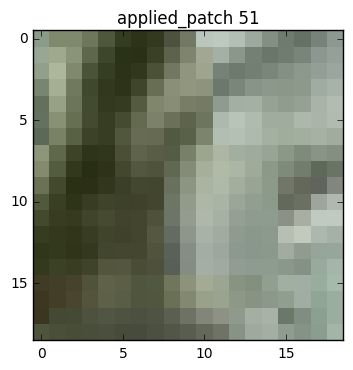

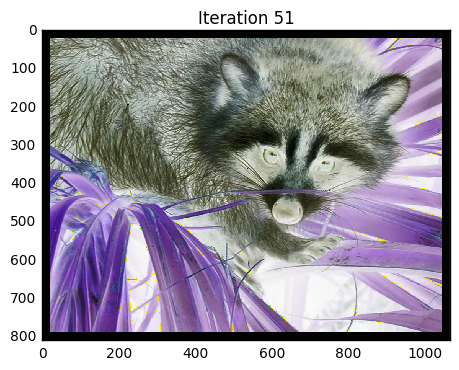

psi = 37
Confidence 0.20203852601
Data 0.253326744492
Priority 0.0511817620561


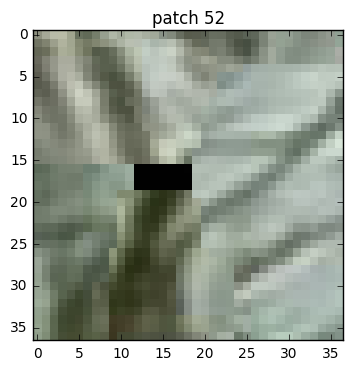

*** Main thread waiting
The queue size is 140000The queue size is 139999

The queue size is 120000
The queue size is 80000
The queue size is 40000
The queue size is 20000
The queue size is 0
*** Done


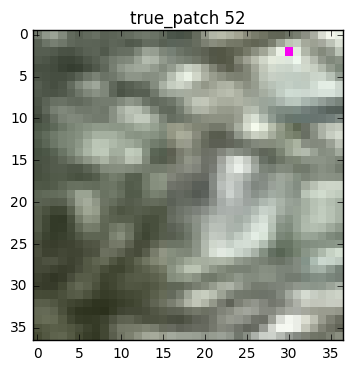

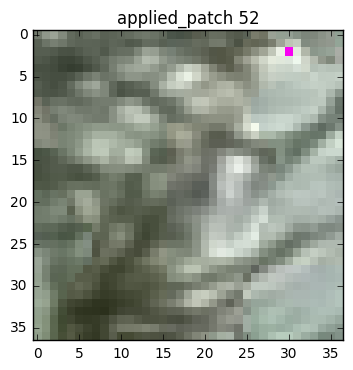

Done


In [6]:
#Initialisation
contours = measure.find_contours(marged_img[:,:,0], 0.8)
criteria, contour = find_good_contour(contours, marged_img)
nb_iter = 0
cut_edges = {}

while criteria:
    
    if nb_iter%1== 0:
        plt.imshow(marged_img, norm=Normalize(vmin=0, vmax=255), interpolation='none')
        plt.title("Iteration " + str(nb_iter))
        plt.show()
    else:
        print("Iteration " + str(nb_iter))
    nb_iter += 1
    
    psi = np.random.randint(9,51) / 2 * 2 + 1
    
    if True:
        print("psi = %s"%psi)
    #Define the contour as tuple
    omega=[(i[0], i[1]) for i in contour]
    
    #Create confidence coefficient for each point
    confidence_vector = [confidence_coefficient(confidence, pt, psi=psi) for pt in omega][1:-1]

    #Compute isophote for each point
    isophote_vector = get_isophote(omega, marged_img)[1:-1]

    #Compute the normal of the border vector for each point
    normal_vector = gen_normal_vector(omega)

    #Compute de data term for each point
    data_vector = gen_data_vector(normal_vector, isophote_vector)

    #Compute the priority term for each term
    priority_vector = [data_vector[i] * confidence_vector[i] for i in range(len(data_vector))]
    
    #Find the point with the highest priority
    m = max(priority_vector)
    indices = [ i for i,j in enumerate(priority_vector) if j==m]
    indice = indices[len(indices)/2]
    patch_x, patch_y = omega[indice+1]
    
    if True:
        print("Confidence "+str(confidence_vector[indice]) )
        print("Data "+str(data_vector[indice]))
        print("Priority "+str(priority_vector[indice]))
    
    #create the patch to find
    patch = marged_img[patch_x - psi/2: patch_x + psi/2+1, patch_y - psi/2: patch_y + psi/2+1]
    
    if True:
        plt.imshow(patch, norm=Normalize(vmin=0, vmax=255), interpolation='none')
        plt.title("patch " + str(nb_iter))
        plt.show()
    
    #Compute the area to compare between the previous patch and the area on the picture
    is_compared = marged_img[patch_x - psi/2: patch_x + psi/2+1, patch_y - psi/2: patch_y + psi/2+1]!=-1
    
    #Find the best match
    result_x, result_y = findbestmatchmulti(patch, marged_img, indicator, is_compared, patch_x, patch_y, psi=psi)
    
    #create the patch to apply
    true_patch = marged_img[result_x - psi/2: result_x + psi/2+1, result_y - psi/2: result_y + psi/2+1].copy()
    enlarged_true_patch = marged_img[result_x - psi/2-1: result_x + psi/2+2,
                                        result_y - psi/2-1: result_y + psi/2+2].copy()
    
    #Create the graph associated
    G = create_graph(marged_img, (patch_x, patch_y), enlarged_true_patch, cut_edges, psi=psi)
    sets = (nx.minimum_cut(G, 'old', 'new', capacity="weight"))
    
    if 'old' in sets[1][0]:
        set_old = sets[1][0]
    else:
        set_old = sets[1][1]
        
    cut_edges = find_cut_edges(G, set_old, cut_edges)
    
    if True:
        plt.imshow(true_patch, norm=Normalize(vmin=0, vmax=255), interpolation='none')
        plt.title("true_patch " + str(nb_iter))
        plt.show()
    
    #Modify the true patch
    applied_patch = true_patch.copy()
    for pt in set_old:
        if (pt!='old'):
            if (pt[0] - patch_x + psi/2>=0) & (pt[0] - patch_x + psi/2<psi) & \
                (pt[1] - patch_y + psi/2>=0) & (pt[1] - patch_y + psi/2<psi):
                applied_patch[pt[0] - patch_x + psi/2, pt[1] - patch_y + psi/2] = \
                                patch[pt[0] - patch_x + psi/2, pt[1] - patch_y + psi/2]
                    
    is_not_compared = 1 - is_compared.astype(int)
    true_patch = is_not_compared * true_patch + is_compared * (true_patch + patch) / 2
    
    if True:
        plt.imshow(applied_patch, norm=Normalize(vmin=0, vmax=255), interpolation='none')
        plt.title("applied_patch " + str(nb_iter))
        plt.show()
        
    if False:
        plt.imshow(applied_patch - true_patch, norm=Normalize(vmin=0, vmax=255), interpolation='none')
        plt.title("applied_patch " + str(nb_iter))
        plt.show()
    
    #Apply it
    marged_img[patch_x - psi/2: patch_x + psi/2+1, patch_y - psi/2: patch_y + psi/2+1]=applied_patch
        
    #Update the condidence matrix, the contour and the looping criteria
    m = confidence_vector[indice]
    confidence[patch_x - psi/2: patch_x + psi/2+1, patch_y - psi/2: patch_y + psi/2+1]=m
    contours = measure.find_contours(marged_img[:, :, 0], 0.8)
    criteria, contour = find_good_contour(contours, marged_img)
    
print("Done")

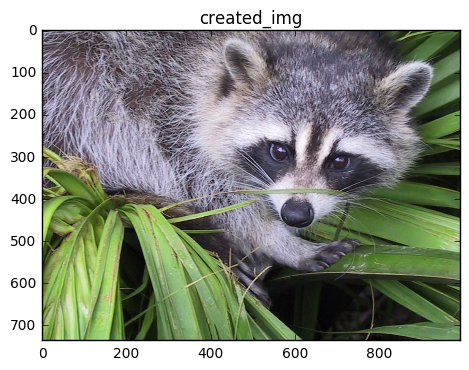

The dim of the image is (810, 1066, 3)


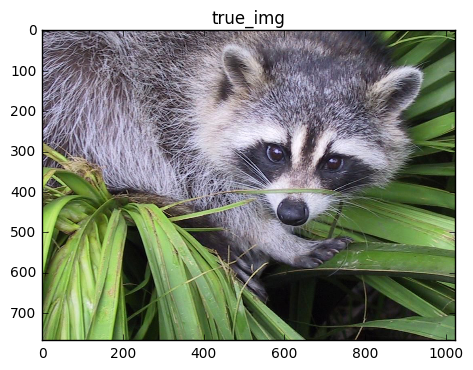

The dim of the image is (810, 1066, 3)


In [7]:
result = marged_img[psi:-psi, psi:-psi].copy().astype(np.uint8)
plt.imshow(result)
plt.title("created_img")
plt.show()
print 'The dim of the image is ' + str(marged_img.shape)
plt.imshow(img)
plt.title("true_img")
plt.show()
print 'The dim of the image is ' + str(marged_img.shape)

In [1]:
plt.imshow(marged_img[150:200, 150:200].astype(np.uint8))
plt.title("marged_img")
plt.show()
print 'The dim of the image is ' + str(marged_img.shape)
plt.imshow(img[140:190, 140:190])
plt.title("true_img")
plt.show()
print 'The dim of the image is ' + str(marged_img.shape)

NameError: name 'plt' is not defined